# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [43]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim = 1)
    #### END CODE HERE ####
    return combined

In [44]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [45]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [46]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [51]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [52]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [53]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 1.75808263027668, discriminator loss: 0.35522813649475576


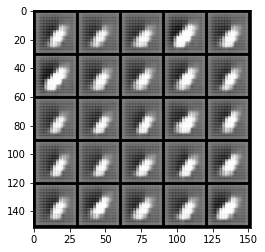

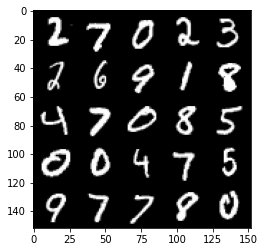

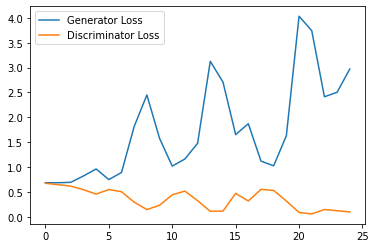

Step 1000: Generator loss: 2.935140343904495, discriminator loss: 0.15599992711097002


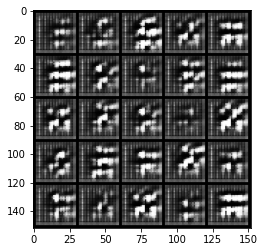

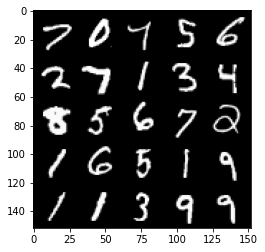

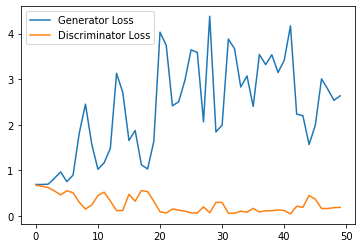

Step 1500: Generator loss: 2.918613962650299, discriminator loss: 0.16664805363863708


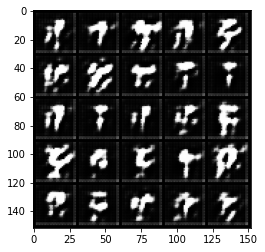

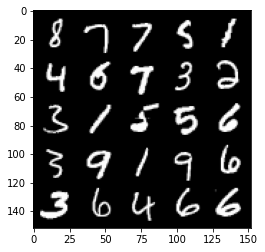

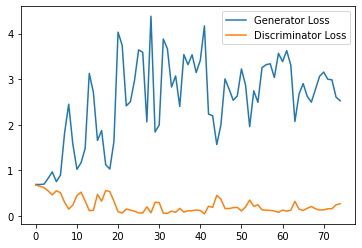

Step 2000: Generator loss: 2.343467422246933, discriminator loss: 0.2597960828393698


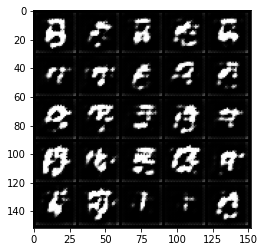

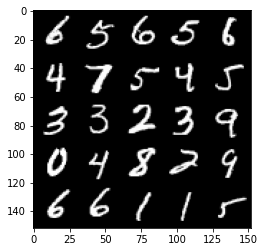

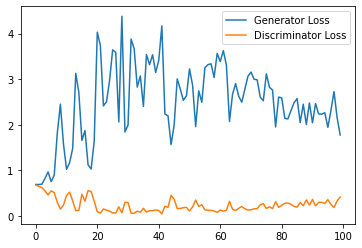

Step 2500: Generator loss: 2.012405884027481, discriminator loss: 0.3435626488029957


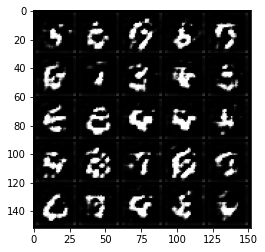

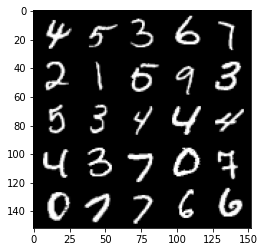

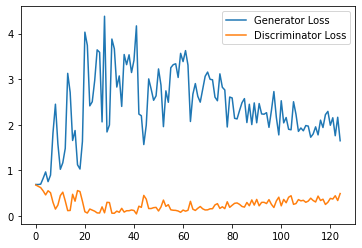

Step 3000: Generator loss: 2.046142327308655, discriminator loss: 0.3141534832715988


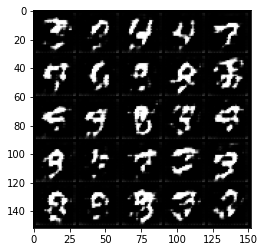

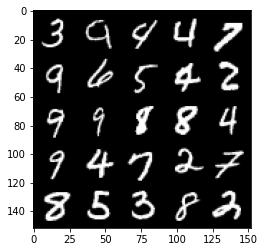

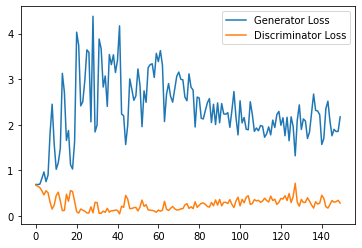

Step 3500: Generator loss: 2.131813873767853, discriminator loss: 0.3359428388178349


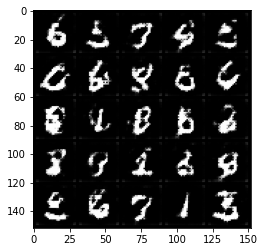

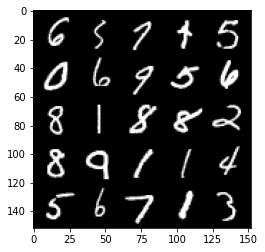

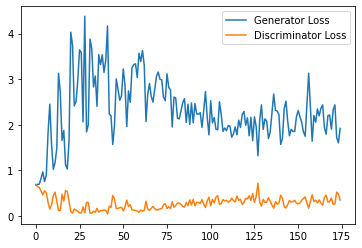

Step 4000: Generator loss: 1.9530854697227478, discriminator loss: 0.3542493886053562


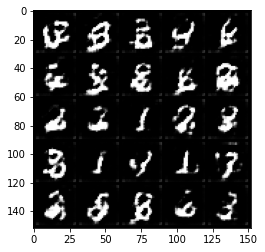

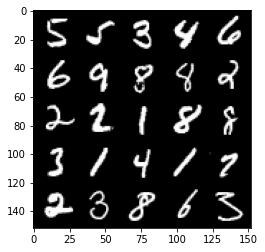

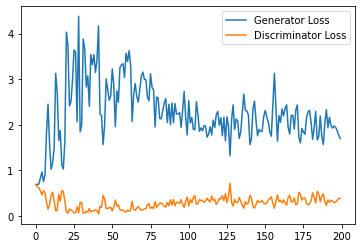

Step 4500: Generator loss: 1.8836532926559448, discriminator loss: 0.36066256815195086


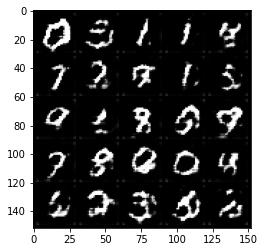

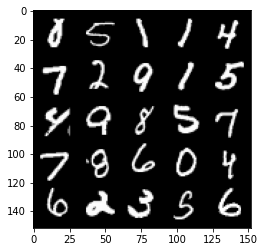

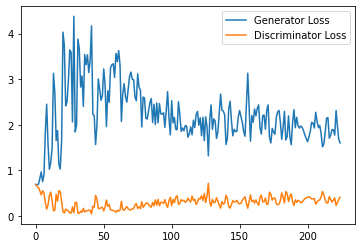

Step 5000: Generator loss: 1.7531794023513794, discriminator loss: 0.3890518868267536


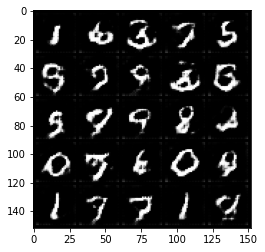

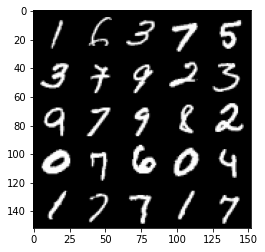

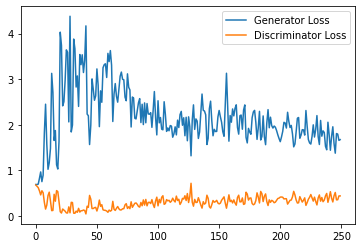

Step 5500: Generator loss: 1.6316802952289582, discriminator loss: 0.41264585039019586


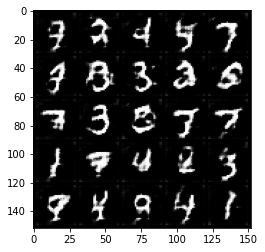

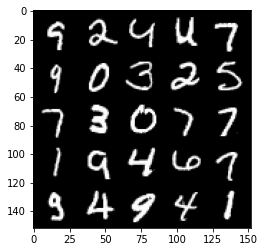

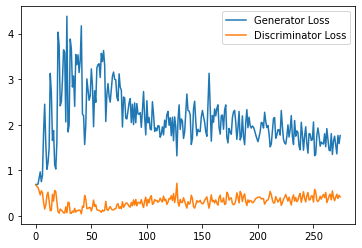

Step 6000: Generator loss: 1.5920738981962204, discriminator loss: 0.42480962935090066


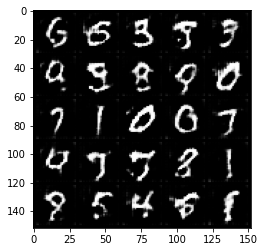

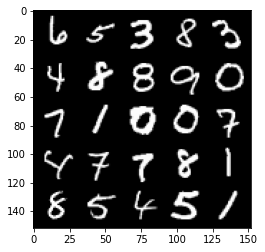

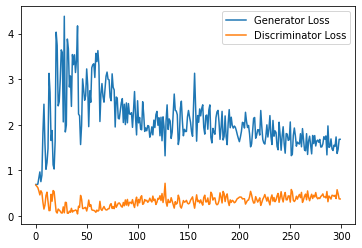

Step 6500: Generator loss: 1.5047046308517456, discriminator loss: 0.4640939574241638


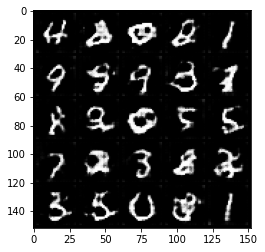

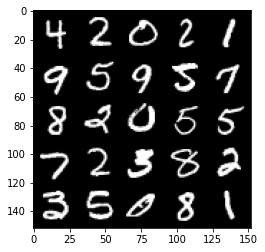

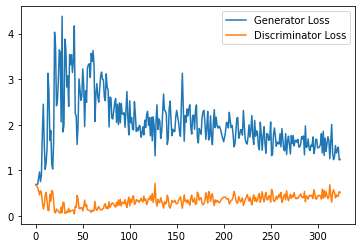

Step 7000: Generator loss: 1.4303521291017531, discriminator loss: 0.48141746562719345


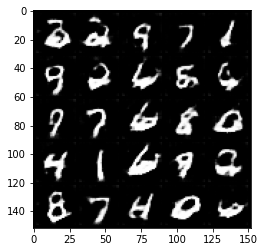

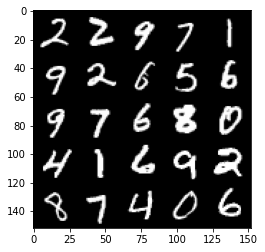

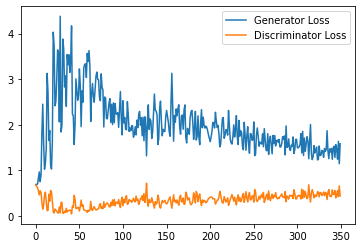

Step 7500: Generator loss: 1.3576902273893356, discriminator loss: 0.4872401044368744


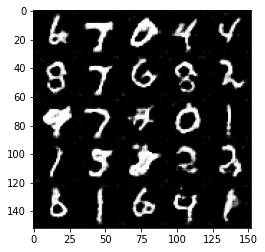

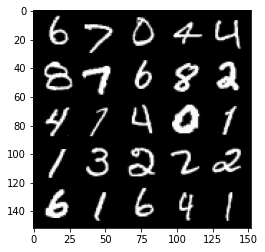

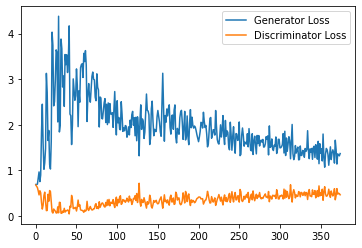

Step 8000: Generator loss: 1.3688360868692397, discriminator loss: 0.49469069510698316


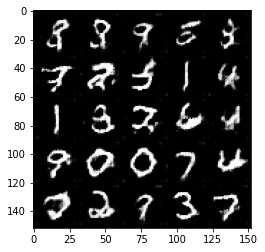

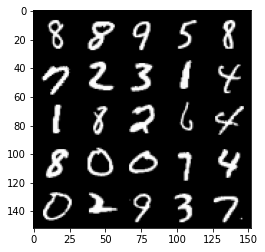

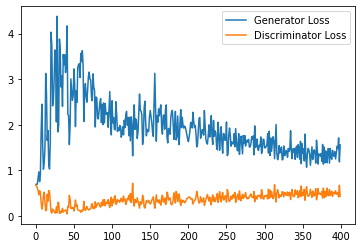

Step 8500: Generator loss: 1.3234538691043853, discriminator loss: 0.5048647937774658


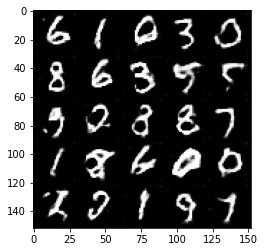

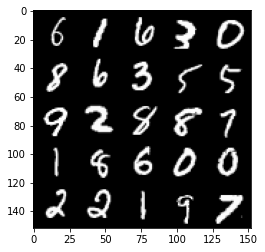

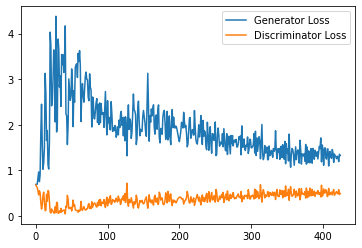

Step 9000: Generator loss: 1.2588710429668426, discriminator loss: 0.5291950210332871


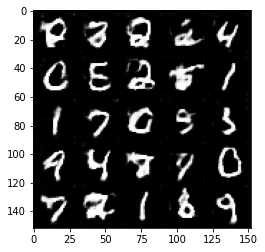

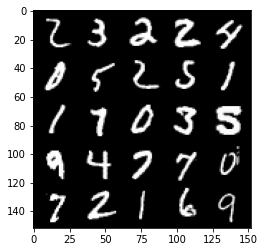

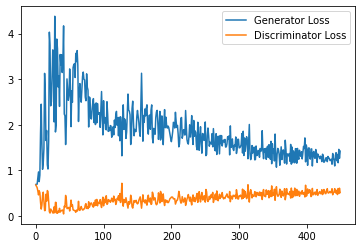

Step 9500: Generator loss: 1.2703345503807069, discriminator loss: 0.5325942089557648


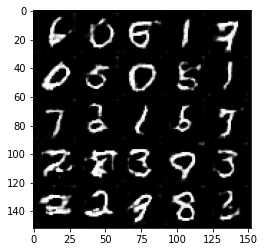

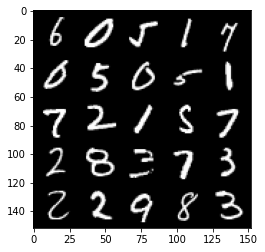

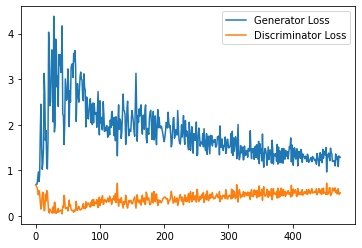

Step 10000: Generator loss: 1.1903843969106673, discriminator loss: 0.5482155912518502


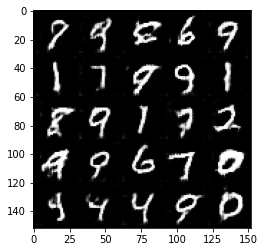

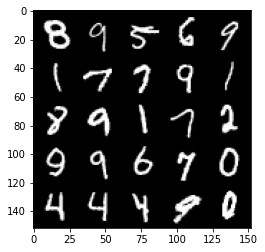

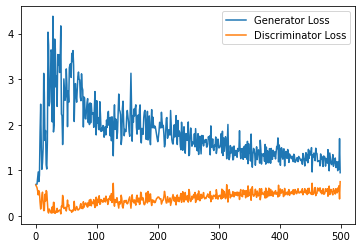

Step 10500: Generator loss: 1.170568005681038, discriminator loss: 0.5477904206514359


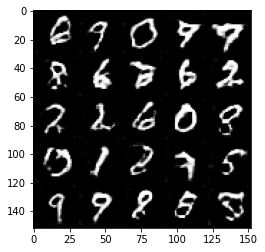

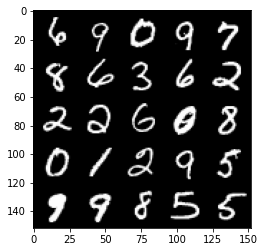

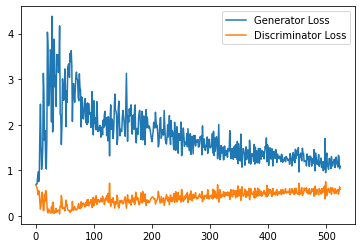

Step 11000: Generator loss: 1.1058752608299256, discriminator loss: 0.560034137070179


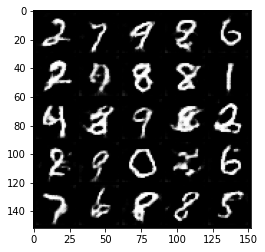

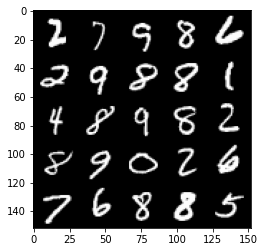

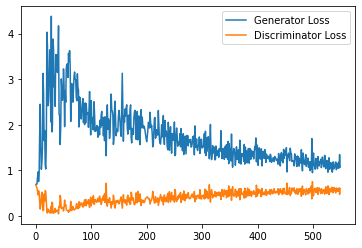

Step 11500: Generator loss: 1.134917220234871, discriminator loss: 0.5616452086567879


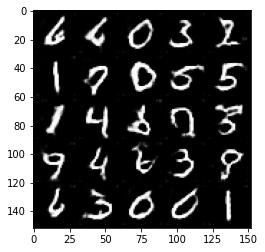

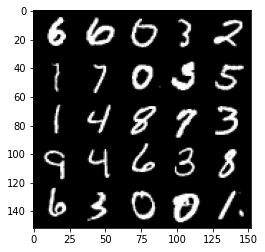

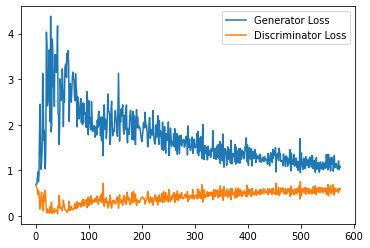

Step 12000: Generator loss: 1.0785293557643891, discriminator loss: 0.5713379368782043


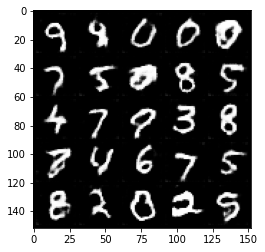

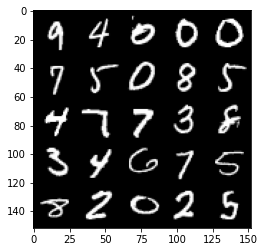

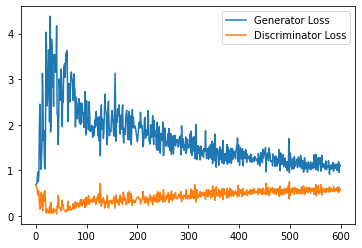

Step 12500: Generator loss: 1.104865952849388, discriminator loss: 0.5748820003867149


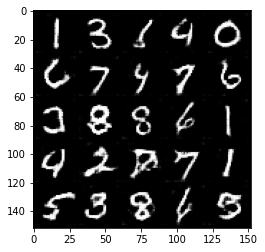

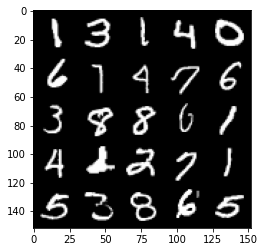

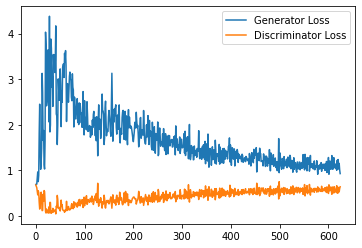

Step 13000: Generator loss: 1.083243309736252, discriminator loss: 0.5694392185807228


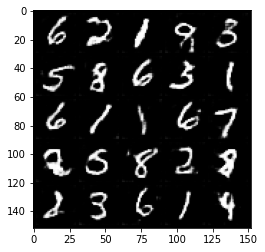

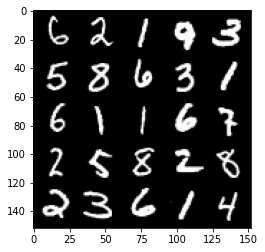

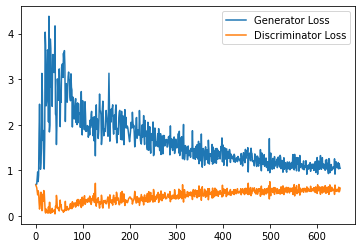

Step 13500: Generator loss: 1.0823103995323182, discriminator loss: 0.5835600178837776


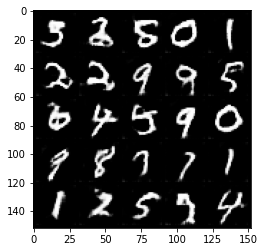

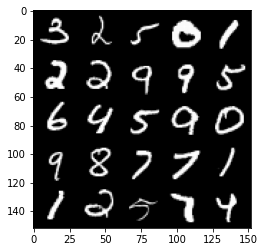

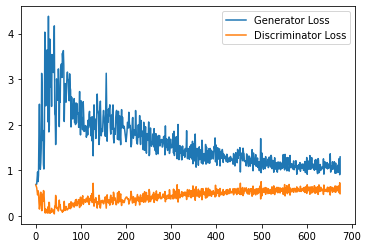

Step 14000: Generator loss: 1.0736632432937623, discriminator loss: 0.5868537274599075


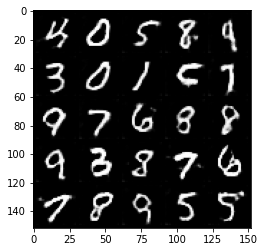

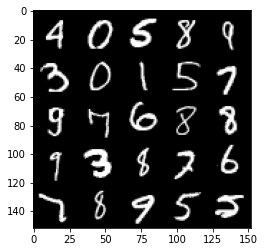

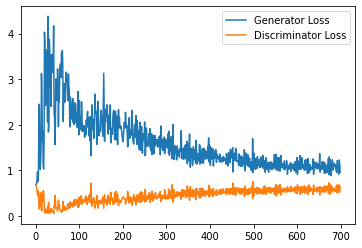

Step 14500: Generator loss: 1.0437617877721785, discriminator loss: 0.5858833774924278


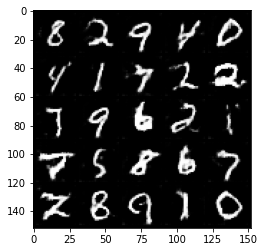

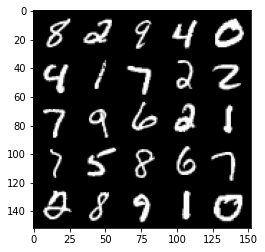

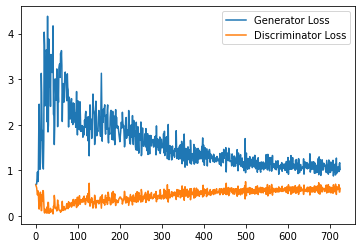

Step 15000: Generator loss: 1.0901628893613815, discriminator loss: 0.5889213131666183


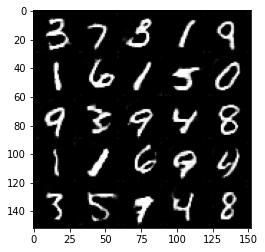

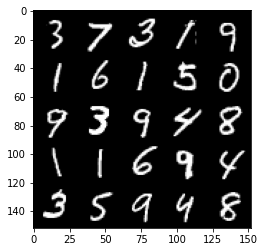

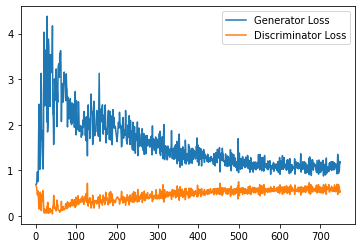

Step 15500: Generator loss: 1.0672251586914063, discriminator loss: 0.5903328446149826


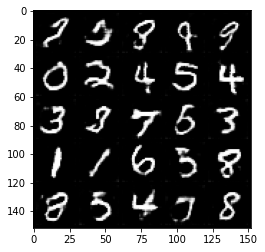

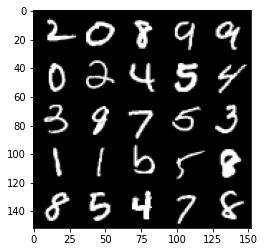

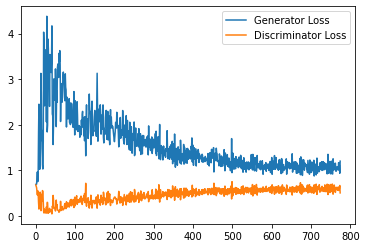

Step 16000: Generator loss: 1.014703064084053, discriminator loss: 0.5936798632144928


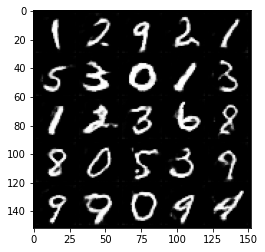

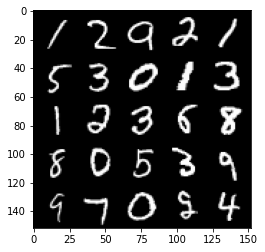

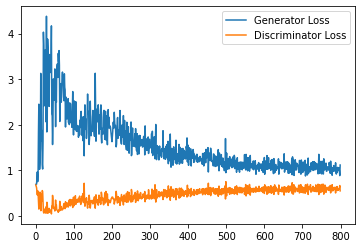

Step 16500: Generator loss: 1.0334240561723709, discriminator loss: 0.5907176592350006


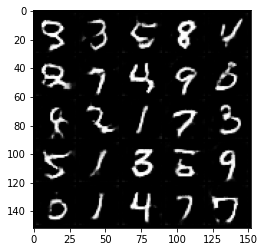

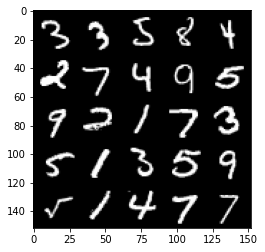

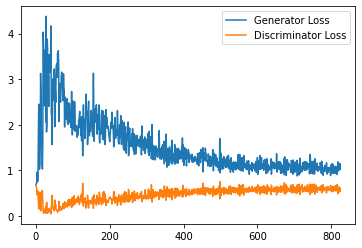

Step 17000: Generator loss: 1.0423760533332824, discriminator loss: 0.5913446279168129


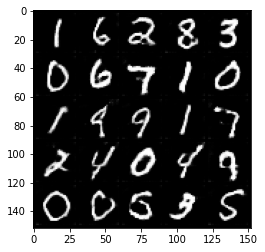

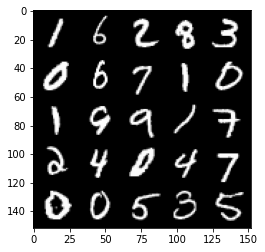

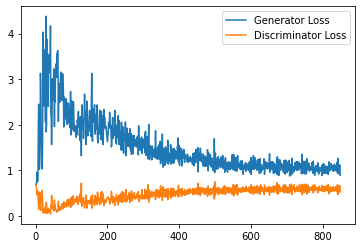

Step 17500: Generator loss: 1.0423824367523193, discriminator loss: 0.5909355022907257


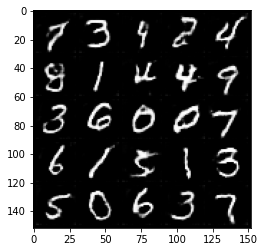

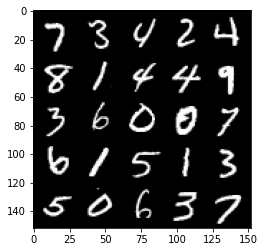

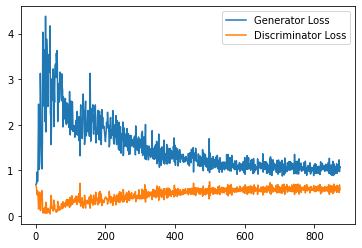

Step 18000: Generator loss: 1.0602162331342697, discriminator loss: 0.5952100682854652


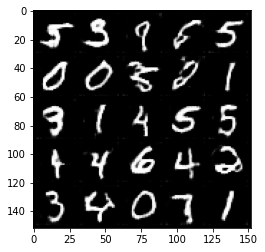

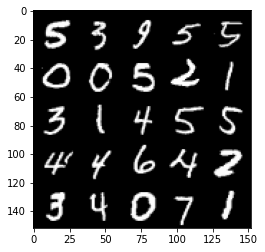

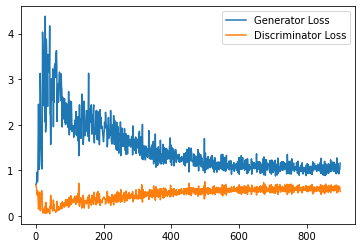

Step 18500: Generator loss: 1.0140014082193374, discriminator loss: 0.5927896817326546


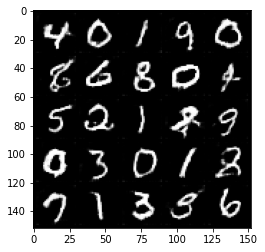

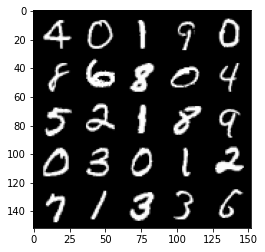

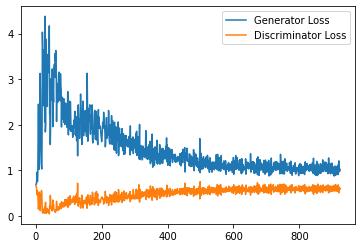

Step 19000: Generator loss: 1.014205573797226, discriminator loss: 0.5954365463256835


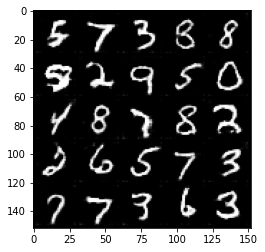

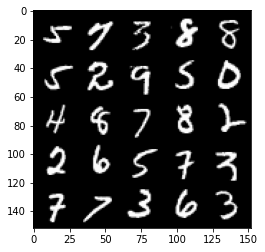

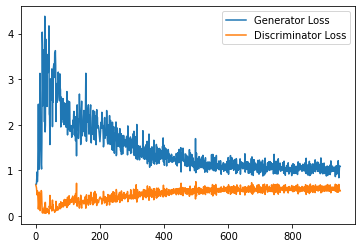

Step 19500: Generator loss: 1.0125661956071854, discriminator loss: 0.6015823822617531


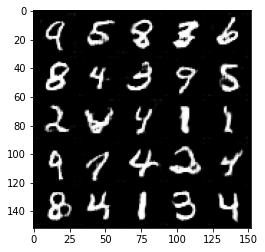

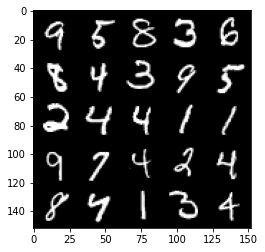

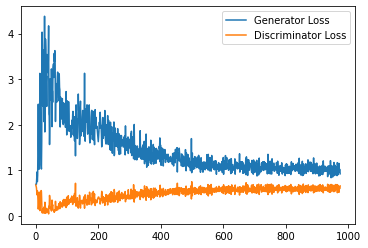

Step 20000: Generator loss: 1.0309208123683928, discriminator loss: 0.5879361179471015


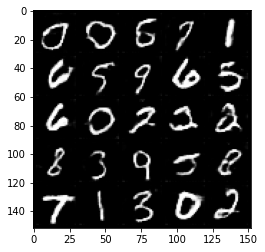

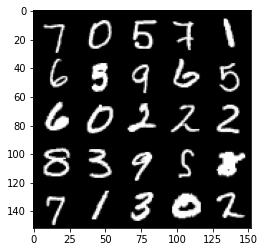

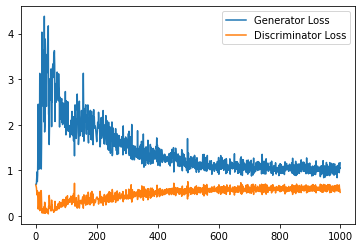

Step 20500: Generator loss: 0.9969322023391723, discriminator loss: 0.59660211789608


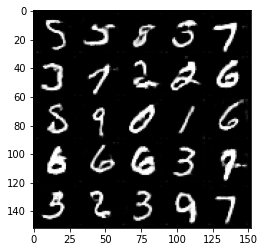

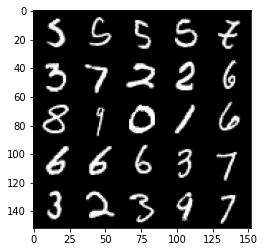

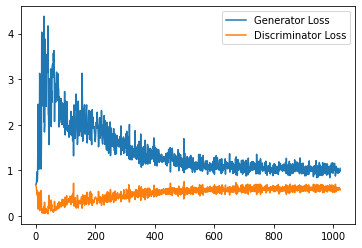

Step 21000: Generator loss: 0.9933515946865081, discriminator loss: 0.5947642789483071


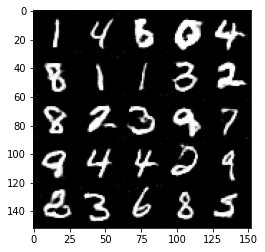

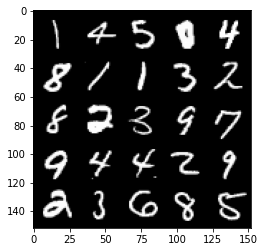

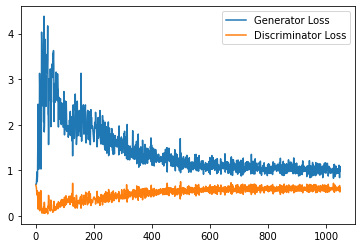

Step 21500: Generator loss: 0.9900741187334061, discriminator loss: 0.591964893400669


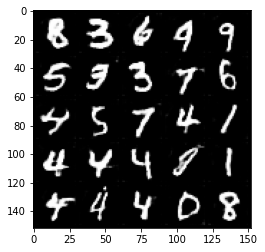

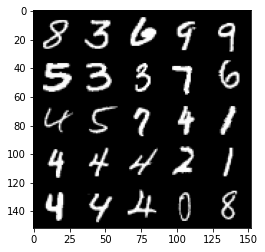

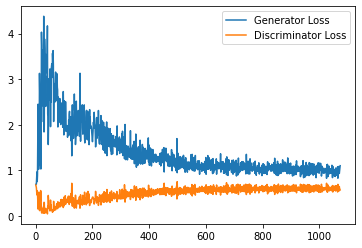

Step 22000: Generator loss: 1.0181361087560654, discriminator loss: 0.5907312426567077


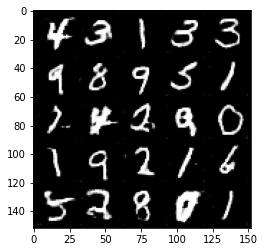

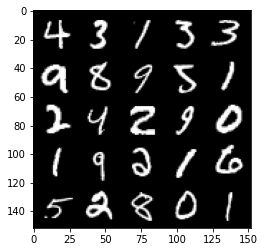

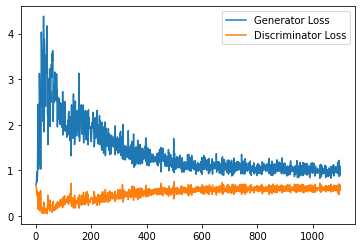

Step 22500: Generator loss: 0.992527736902237, discriminator loss: 0.5895892645716667


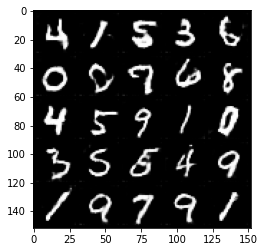

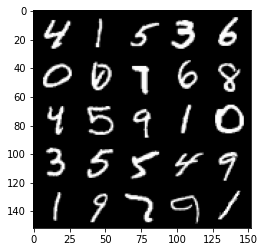

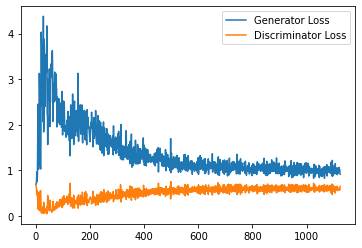

Step 23000: Generator loss: 1.0157477573156357, discriminator loss: 0.5917802689671516


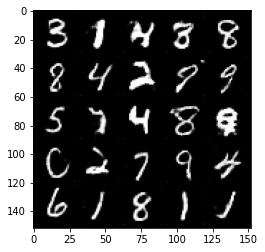

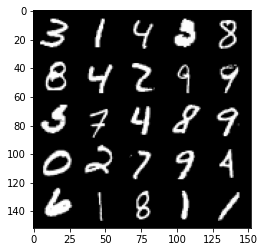

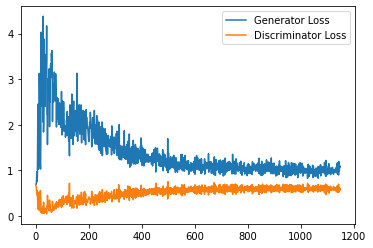

Step 23500: Generator loss: 1.0151865088939667, discriminator loss: 0.5984287054538727


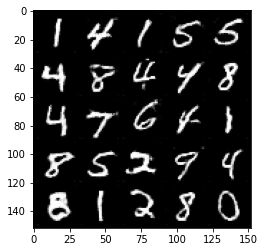

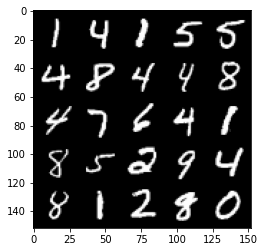

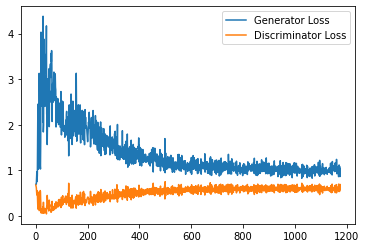

Step 24000: Generator loss: 0.9881607336997986, discriminator loss: 0.5919218376278877


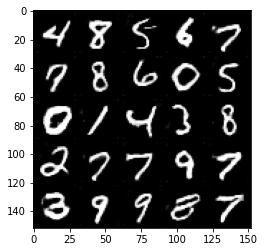

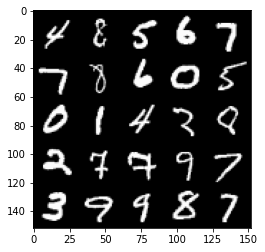

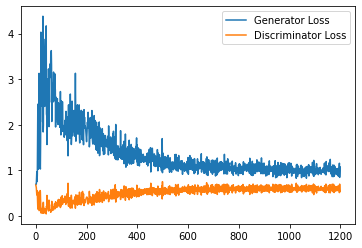

Step 24500: Generator loss: 0.9906843677759171, discriminator loss: 0.5941486971378327


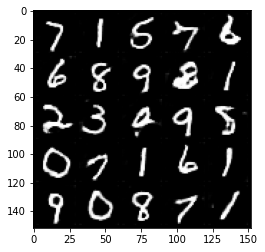

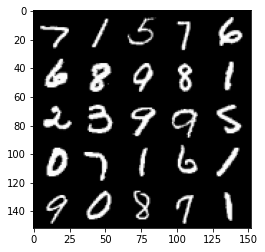

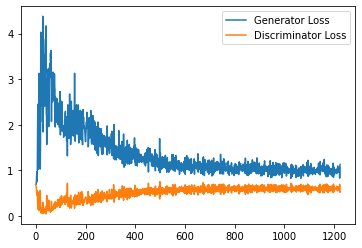

Step 25000: Generator loss: 0.9922470979690552, discriminator loss: 0.6022219925522804


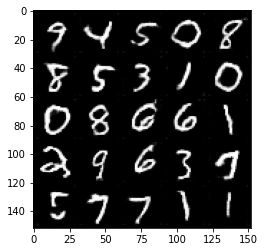

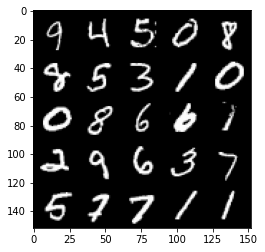

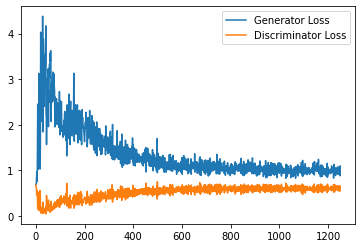

Step 25500: Generator loss: 0.991190483212471, discriminator loss: 0.602129575252533


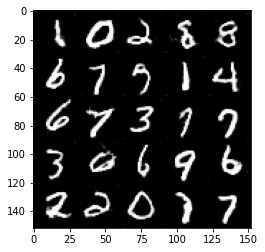

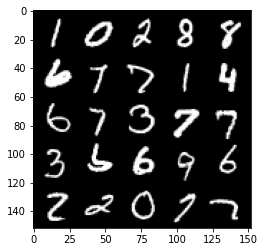

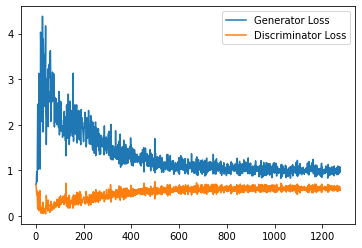

Step 26000: Generator loss: 0.9739187017679215, discriminator loss: 0.6062069276571274


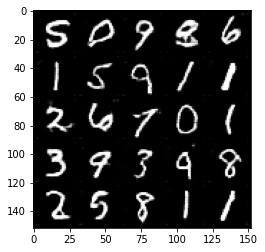

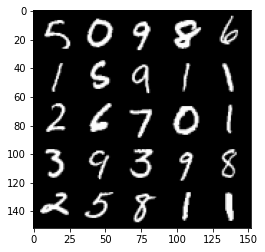

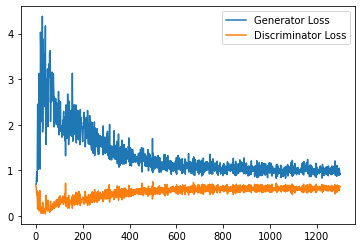

Step 26500: Generator loss: 0.9915400290489197, discriminator loss: 0.5966874898076058


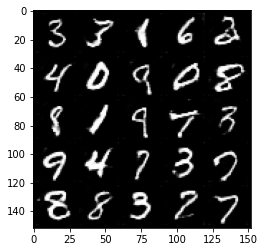

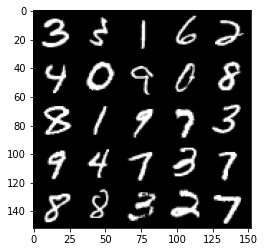

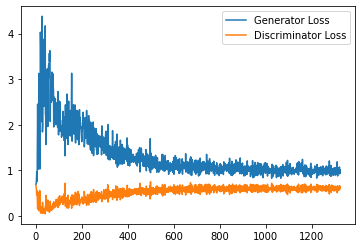

Step 27000: Generator loss: 1.0003845083713532, discriminator loss: 0.6004779009222985


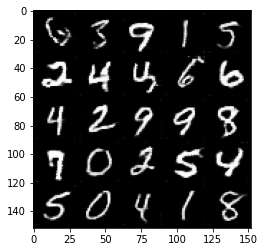

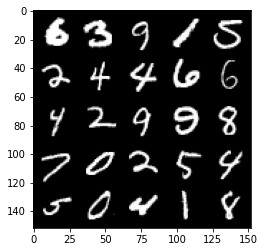

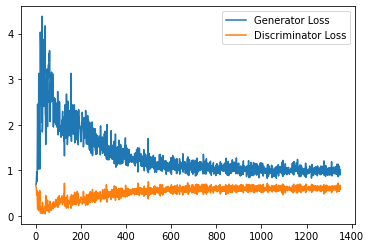

Step 27500: Generator loss: 1.0054033312797546, discriminator loss: 0.5999228730201721


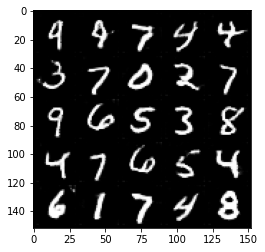

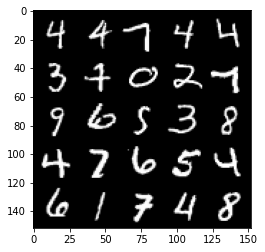

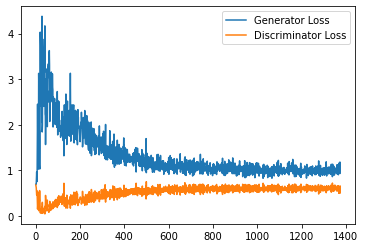

Step 28000: Generator loss: 1.00700042116642, discriminator loss: 0.5945644299387932


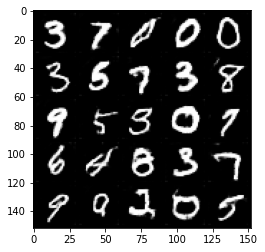

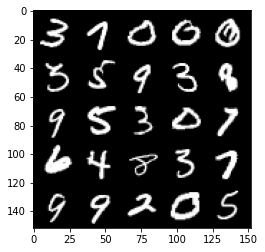

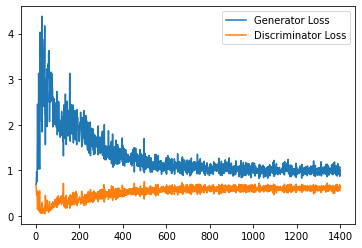

Step 28500: Generator loss: 0.9724126135110855, discriminator loss: 0.5992155407071114


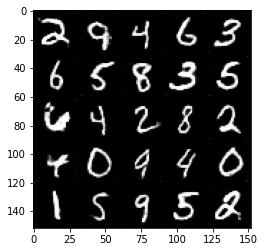

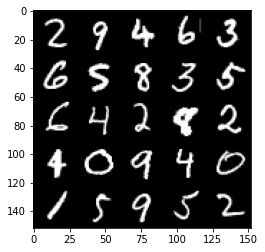

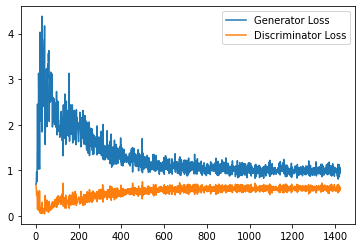

Step 29000: Generator loss: 0.9829773359298706, discriminator loss: 0.5969866733551026


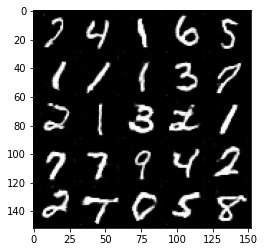

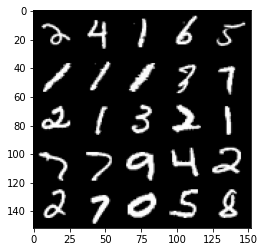

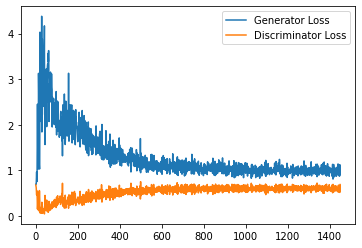

Step 29500: Generator loss: 0.9903764533996582, discriminator loss: 0.5993763783574104


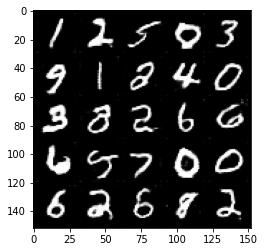

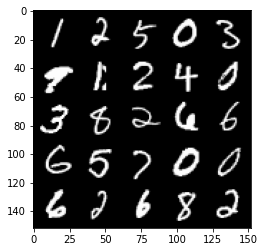

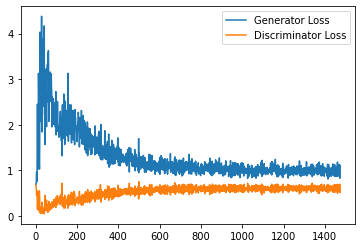

Step 30000: Generator loss: 0.9887513040304184, discriminator loss: 0.6021140744686126


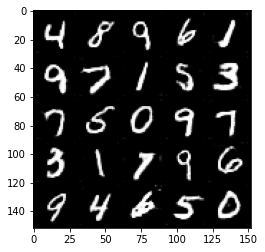

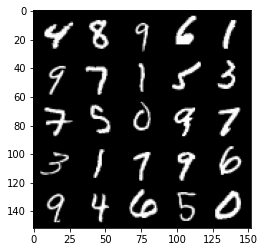

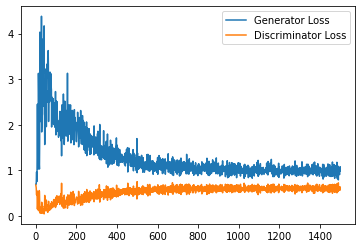

Step 30500: Generator loss: 1.0033694336414336, discriminator loss: 0.5991930655241012


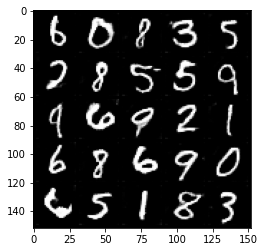

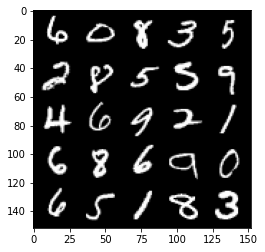

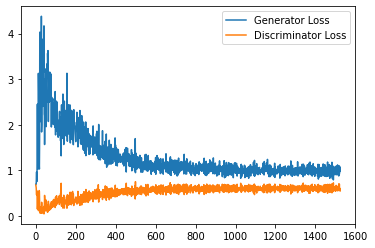

Step 31000: Generator loss: 0.9900074526071548, discriminator loss: 0.6046496583223343


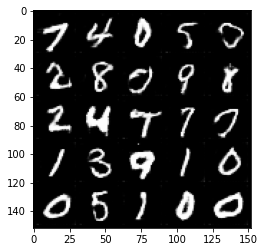

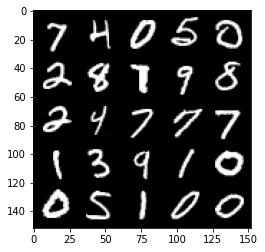

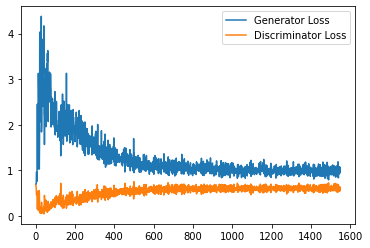

Step 31500: Generator loss: 0.9702561913728714, discriminator loss: 0.5943666691184044


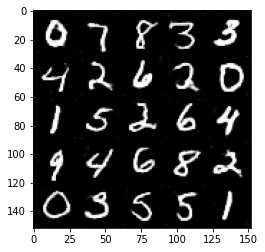

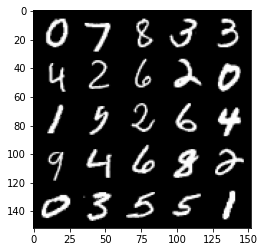

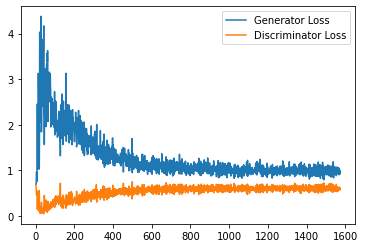

Step 32000: Generator loss: 0.9869593349695206, discriminator loss: 0.6026304643154144


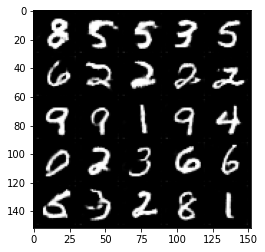

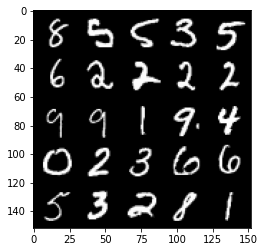

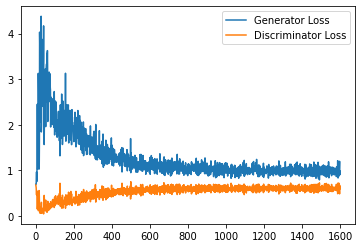

Step 32500: Generator loss: 0.9766742783784866, discriminator loss: 0.5955741427540779


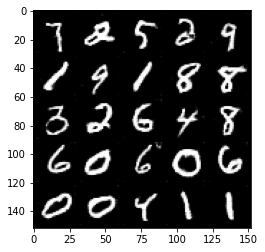

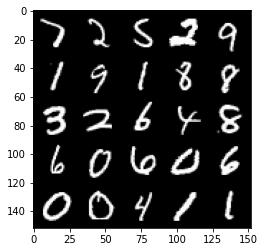

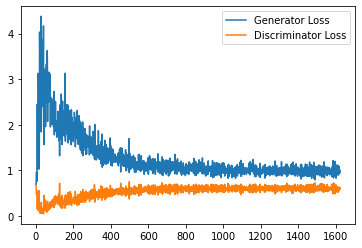

Step 33000: Generator loss: 1.0081137169599532, discriminator loss: 0.5957465942502022


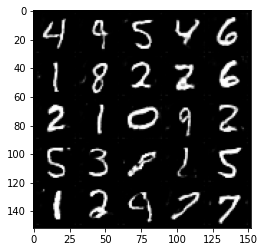

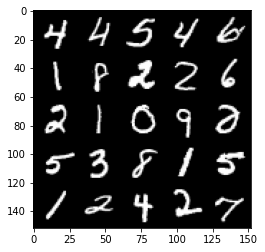

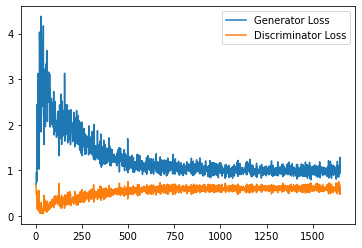

Step 33500: Generator loss: 0.9717640472650528, discriminator loss: 0.6025627775788307


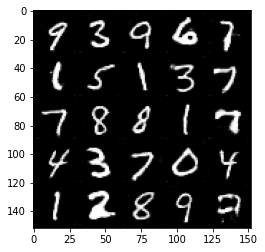

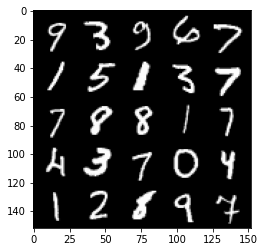

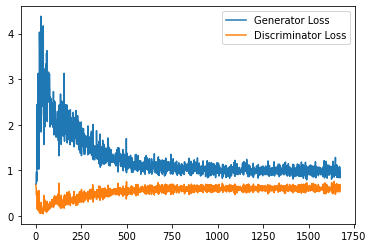

Step 34000: Generator loss: 0.9736715300083161, discriminator loss: 0.594600684940815


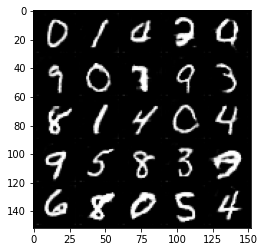

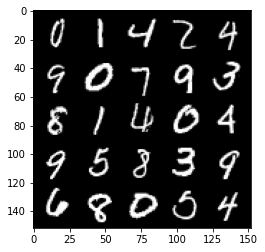

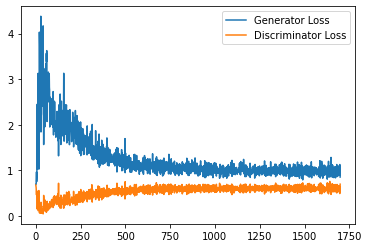

Step 34500: Generator loss: 0.991532788515091, discriminator loss: 0.5993073053359985


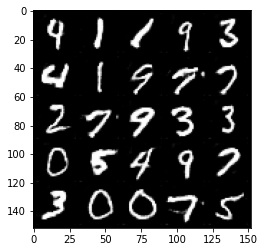

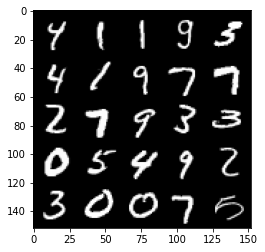

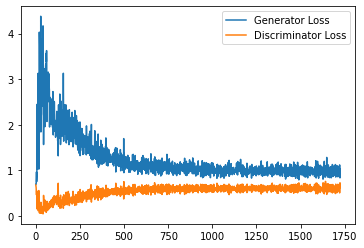

Step 35000: Generator loss: 1.0288811795711517, discriminator loss: 0.591388579249382


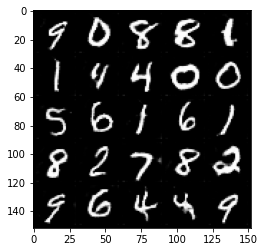

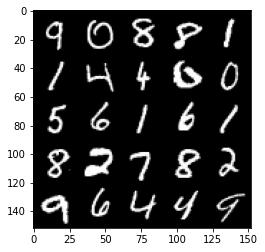

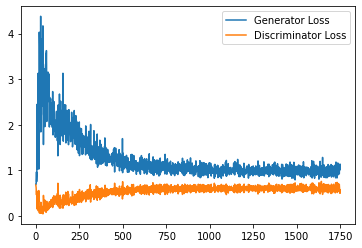

Step 35500: Generator loss: 1.0014060797691344, discriminator loss: 0.6015152087807656


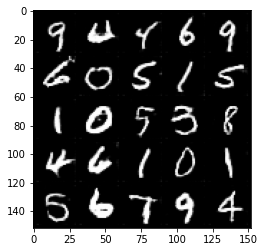

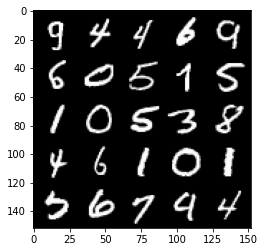

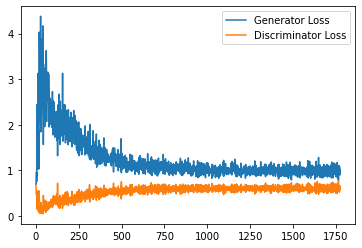

Step 36000: Generator loss: 0.9744092955589294, discriminator loss: 0.5990334045290947


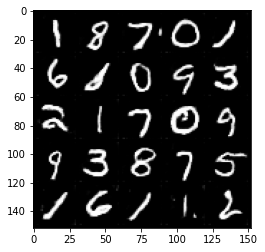

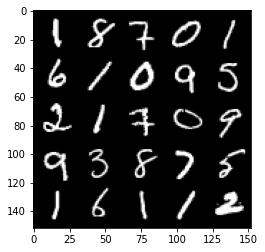

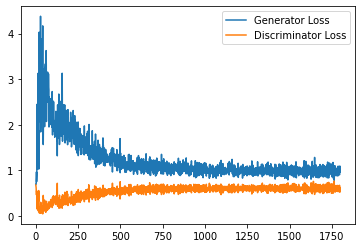

Step 36500: Generator loss: 0.985600730061531, discriminator loss: 0.6046839881539344


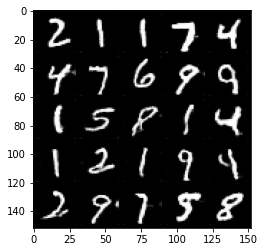

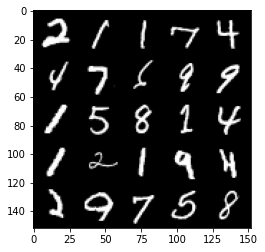

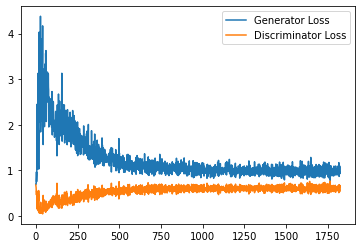

Step 37000: Generator loss: 0.9854771349430084, discriminator loss: 0.5968020367026329


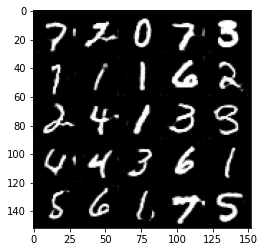

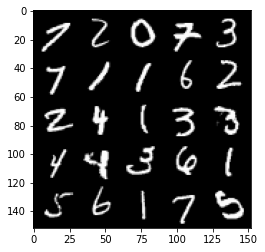

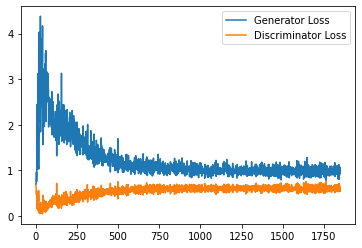

Step 37500: Generator loss: 1.0017916765213013, discriminator loss: 0.593238323688507


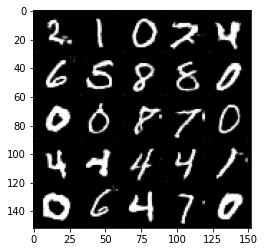

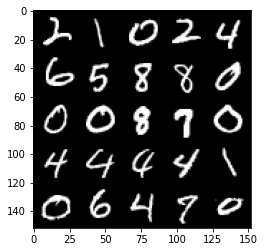

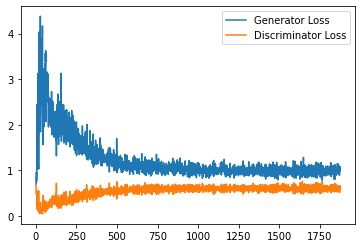

Step 38000: Generator loss: 1.0156664402484894, discriminator loss: 0.5888978254199028


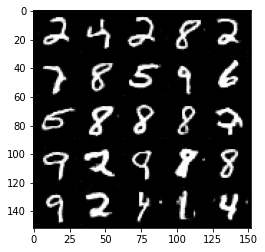

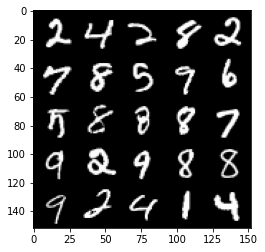

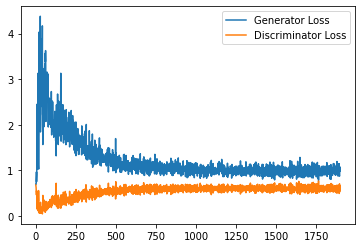

Step 38500: Generator loss: 0.9947538998126984, discriminator loss: 0.5921625673770905


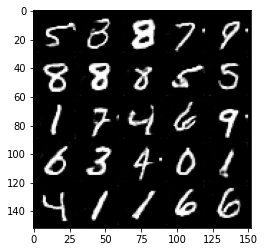

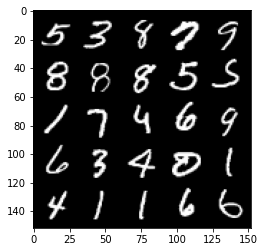

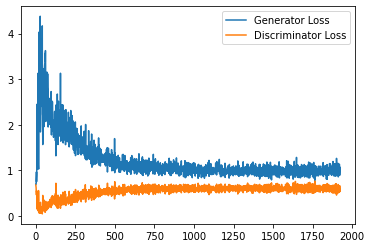

Step 39000: Generator loss: 0.996871556520462, discriminator loss: 0.5965444398522377


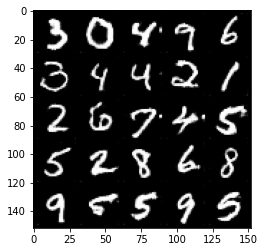

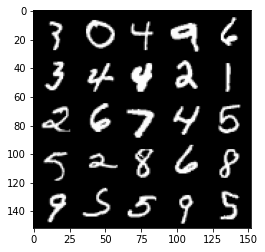

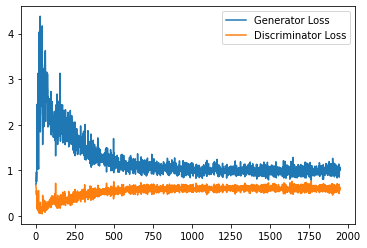

Step 39500: Generator loss: 1.0257655384540558, discriminator loss: 0.5914638980627059


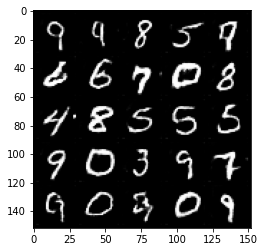

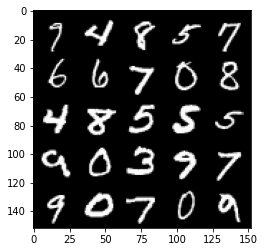

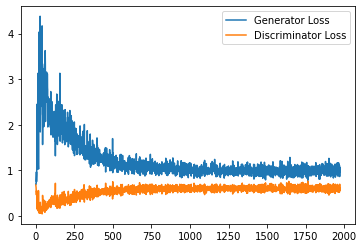

Step 40000: Generator loss: 0.9856137706041336, discriminator loss: 0.5958678095340729


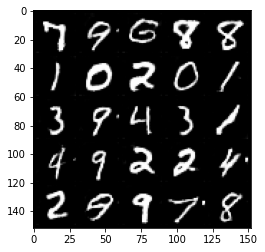

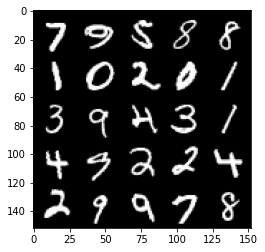

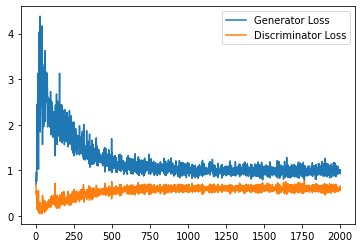

Step 40500: Generator loss: 1.0157680118083954, discriminator loss: 0.5910684052705765


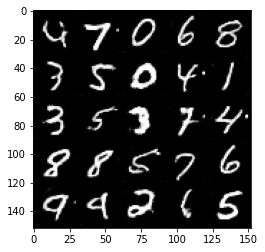

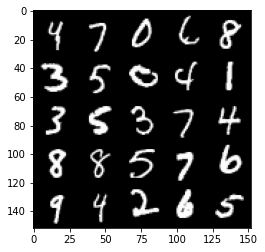

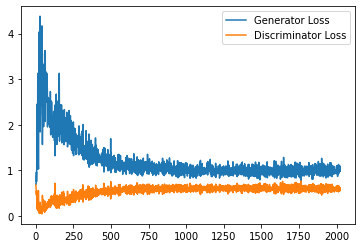

Step 41000: Generator loss: 1.0071387583017348, discriminator loss: 0.5945589790940284


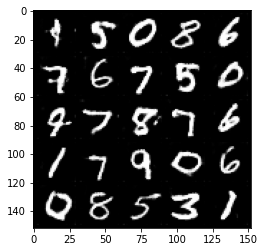

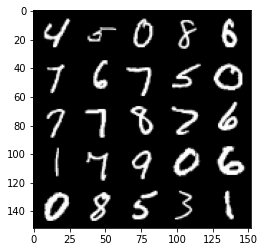

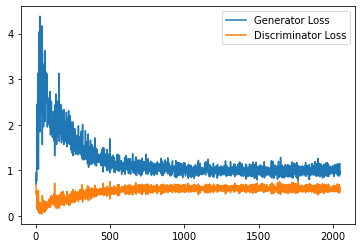

Step 41500: Generator loss: 0.9993805357217789, discriminator loss: 0.5938379811644554


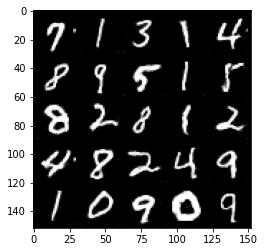

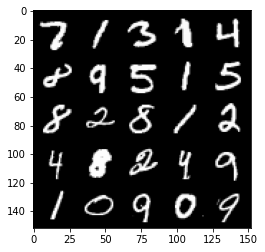

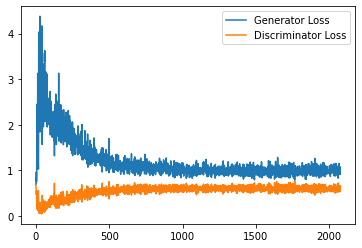

Step 42000: Generator loss: 1.0049212309122086, discriminator loss: 0.5865480764508247


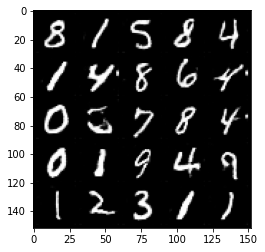

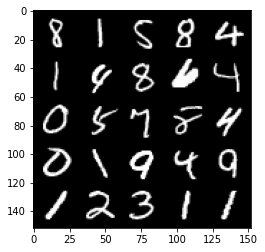

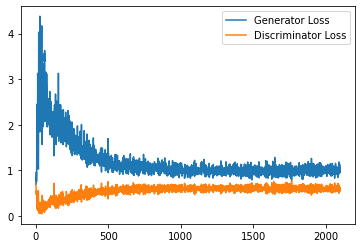

Step 42500: Generator loss: 1.0217589235305786, discriminator loss: 0.5930930640101433


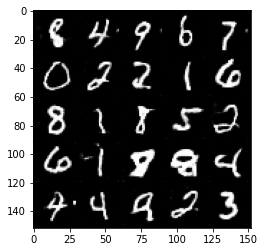

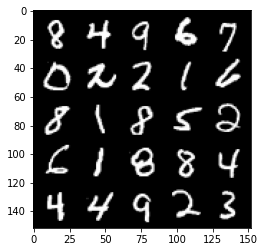

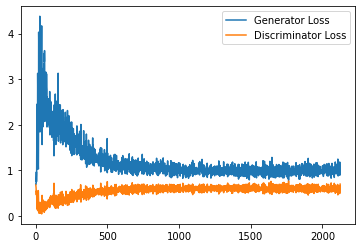

Step 43000: Generator loss: 1.0262607061862945, discriminator loss: 0.5872064566612244


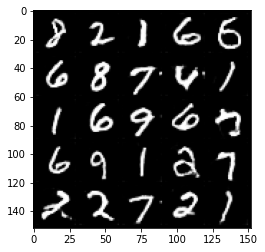

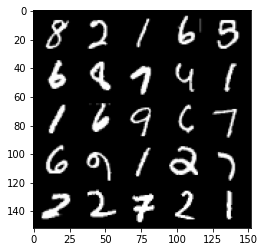

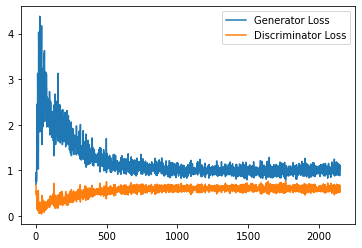

Step 43500: Generator loss: 1.0270928364992142, discriminator loss: 0.5843638410568237


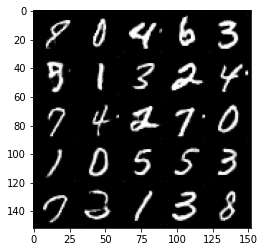

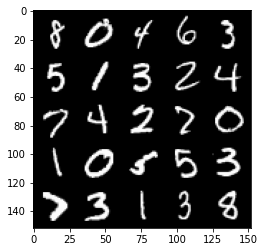

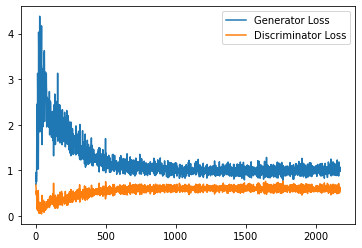

Step 44000: Generator loss: 1.0072027992010117, discriminator loss: 0.5989477568864823


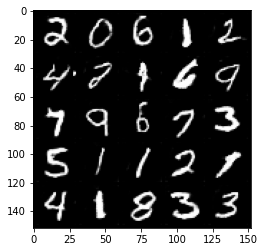

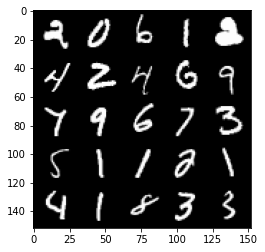

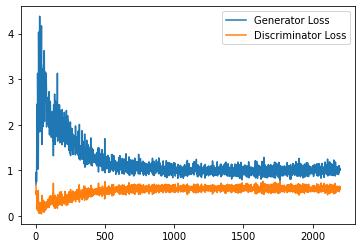

Step 44500: Generator loss: 0.9934970570802688, discriminator loss: 0.5972559214830399


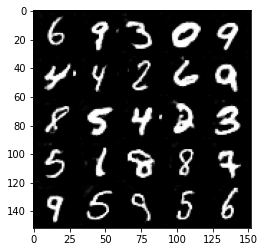

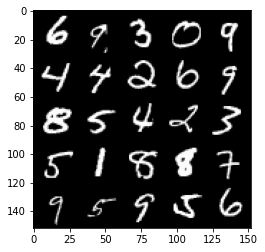

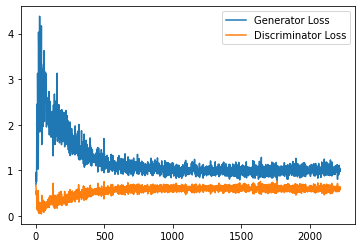

Step 45000: Generator loss: 1.0178268716335297, discriminator loss: 0.5862053701877594


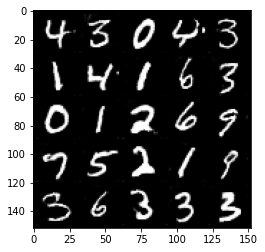

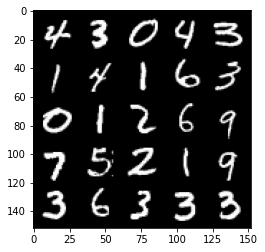

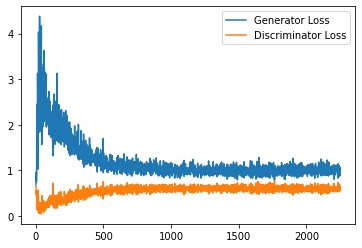

Step 45500: Generator loss: 1.0260487856864928, discriminator loss: 0.5832877916693687


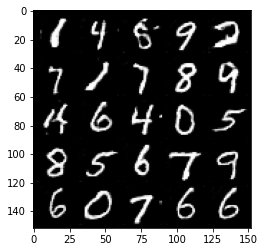

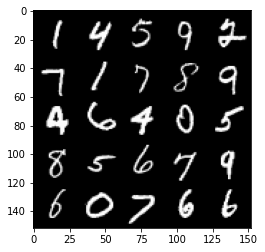

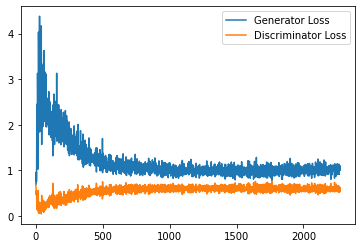

Step 46000: Generator loss: 1.0128852307796479, discriminator loss: 0.58606589448452


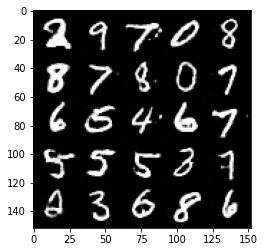

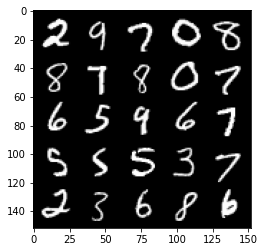

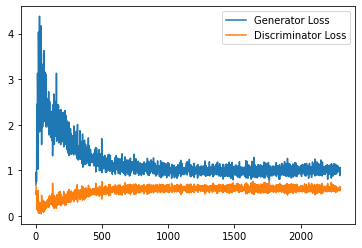

Step 46500: Generator loss: 0.9999096169471741, discriminator loss: 0.5872573107481003


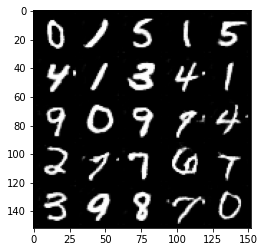

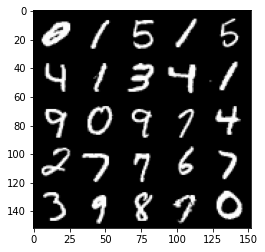

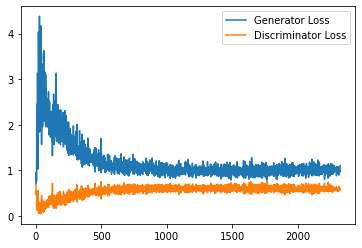

Step 47000: Generator loss: 1.0203148906230926, discriminator loss: 0.5838245333433151


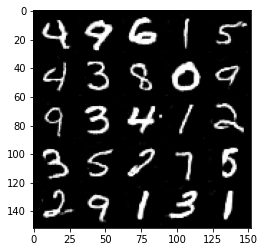

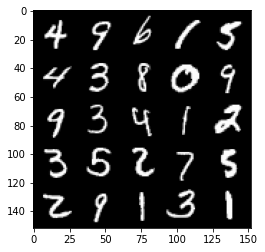

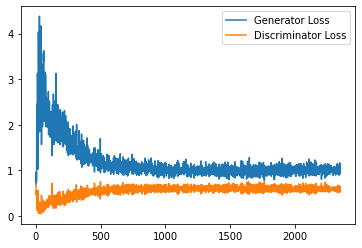

Step 47500: Generator loss: 1.0351937892436982, discriminator loss: 0.5796505766510963


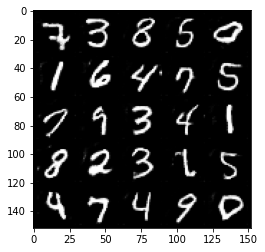

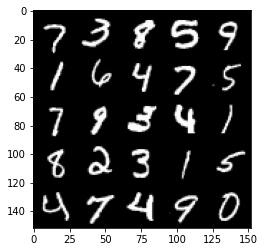

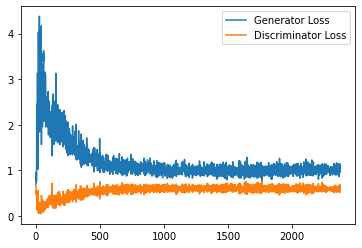

Step 48000: Generator loss: 1.0096187198162079, discriminator loss: 0.5900294913649559


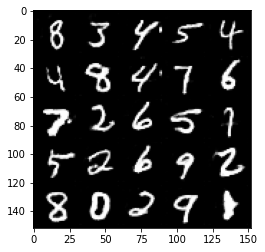

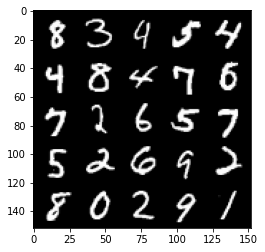

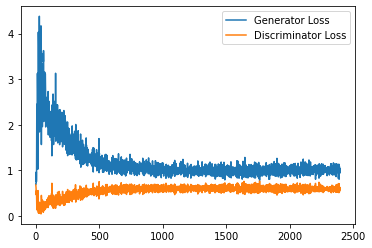

Step 48500: Generator loss: 1.0137385808229447, discriminator loss: 0.5856984222531318


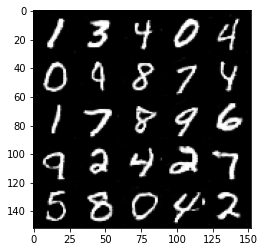

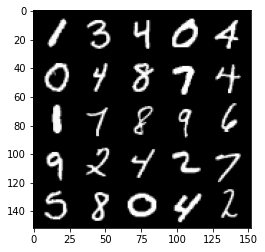

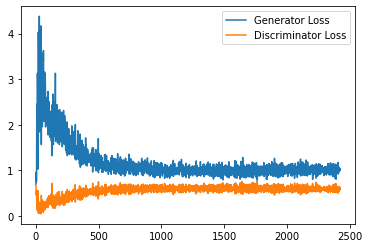

Step 49000: Generator loss: 1.0407128973007203, discriminator loss: 0.5798178848028183


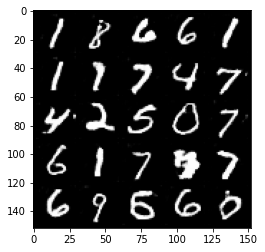

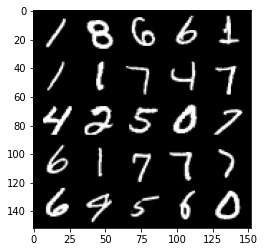

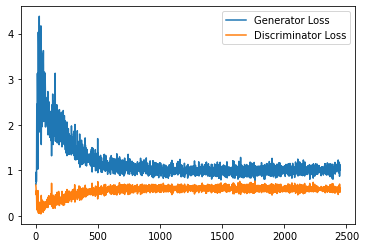

Step 49500: Generator loss: 1.0441836718320847, discriminator loss: 0.5814353893995285


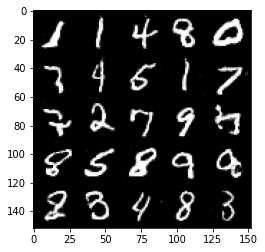

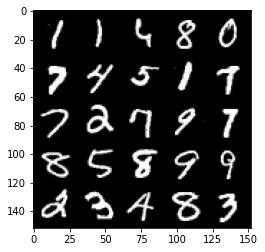

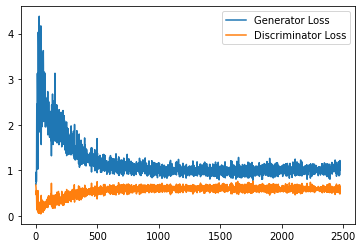

Step 50000: Generator loss: 1.039454492688179, discriminator loss: 0.5765813630819321


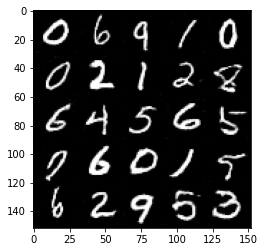

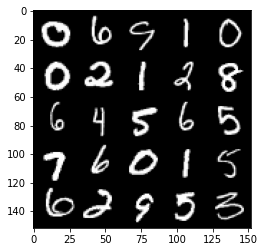

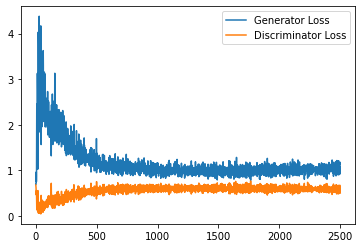

Step 50500: Generator loss: 1.0221289813518524, discriminator loss: 0.579247695505619


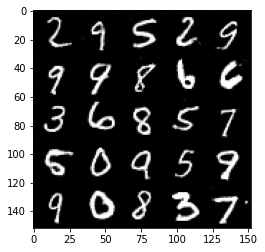

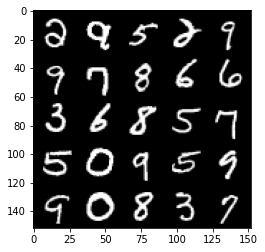

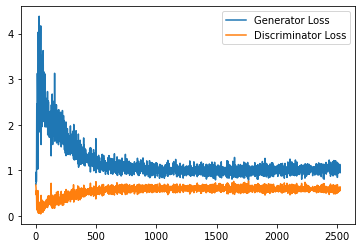

Step 51000: Generator loss: 1.045558803677559, discriminator loss: 0.5776979999542237


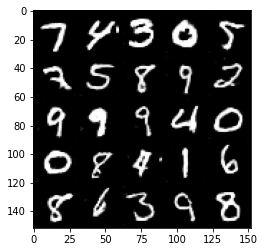

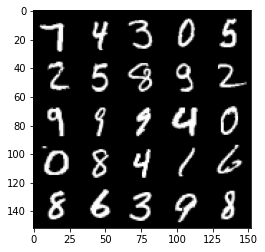

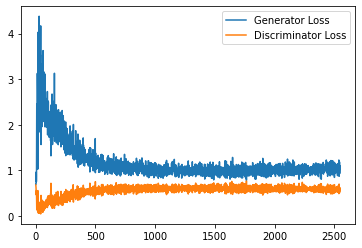

Step 51500: Generator loss: 1.0184332103729248, discriminator loss: 0.5828078916072845


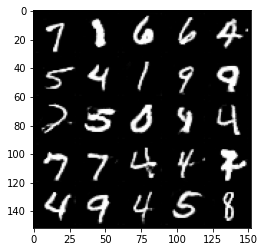

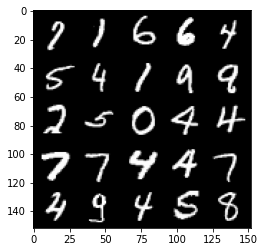

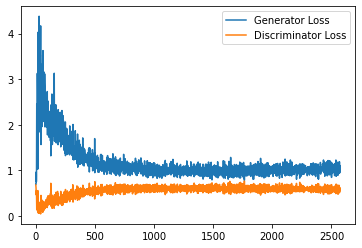

Step 52000: Generator loss: 1.0379188792705536, discriminator loss: 0.5807160748243332


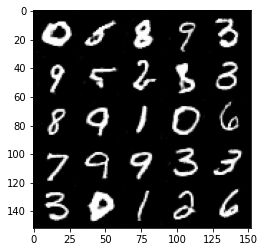

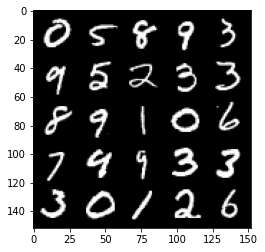

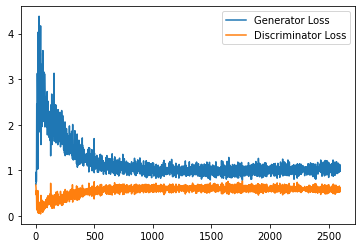

Step 52500: Generator loss: 1.0512143937349319, discriminator loss: 0.5786065084338188


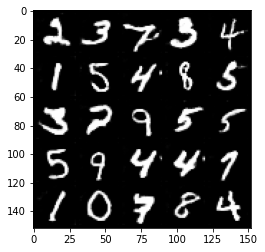

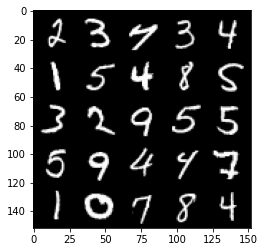

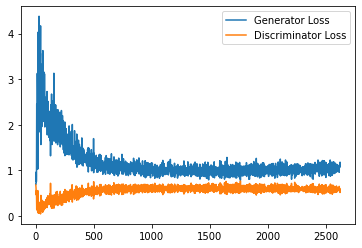

Step 53000: Generator loss: 1.0232569944858552, discriminator loss: 0.5825773200392723


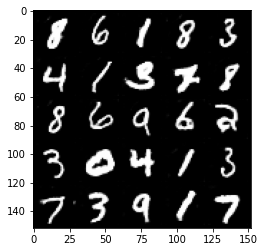

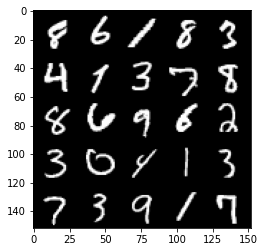

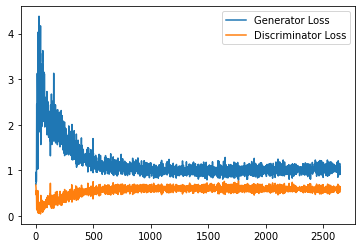

Step 53500: Generator loss: 1.022722060084343, discriminator loss: 0.5779276077151299


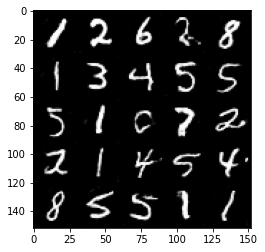

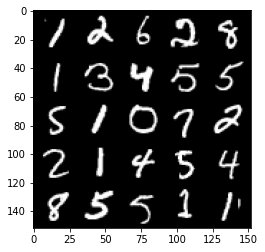

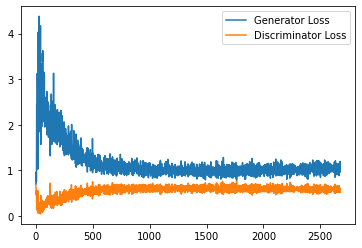

Step 54000: Generator loss: 1.0271223585605622, discriminator loss: 0.5841301607489586


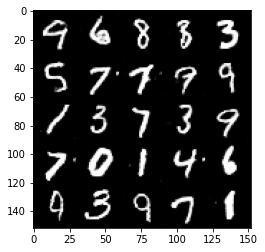

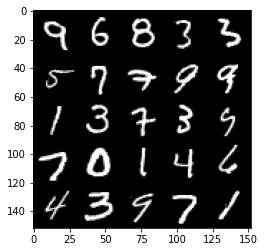

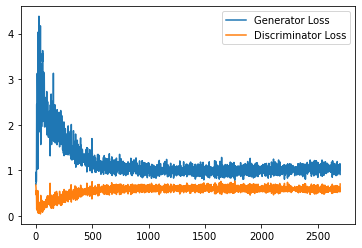

Step 54500: Generator loss: 1.0632442866563796, discriminator loss: 0.5777634209394455


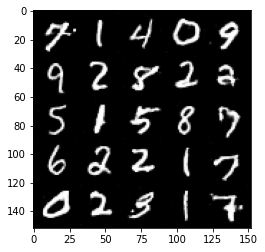

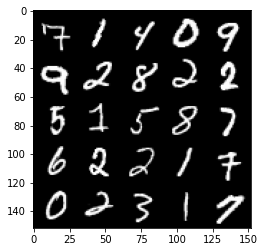

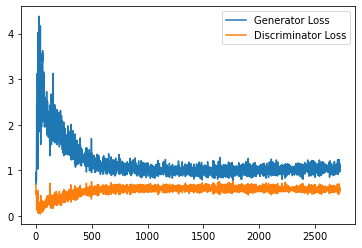

Step 55000: Generator loss: 1.0253170907497406, discriminator loss: 0.5749694553017616


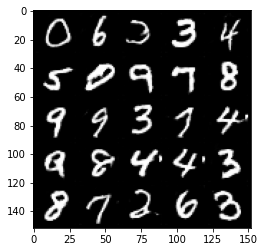

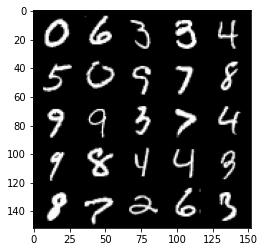

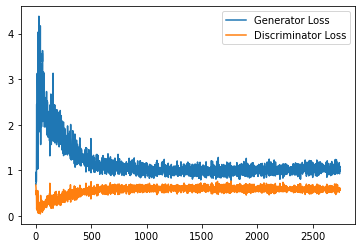

Step 55500: Generator loss: 1.0402848975658416, discriminator loss: 0.5752736750245094


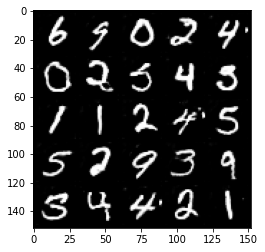

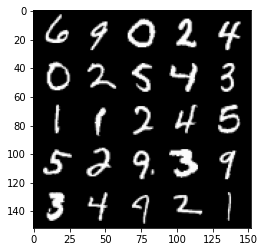

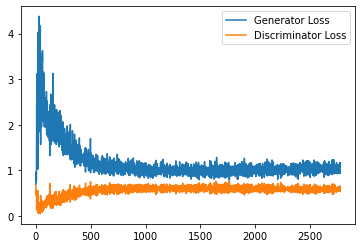

Step 56000: Generator loss: 1.0638545496463776, discriminator loss: 0.5766761240959167


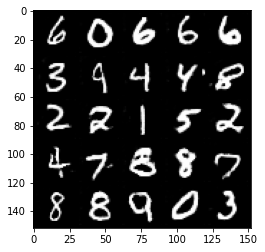

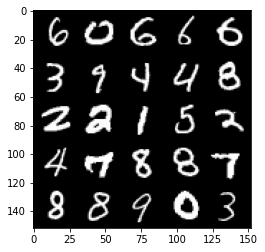

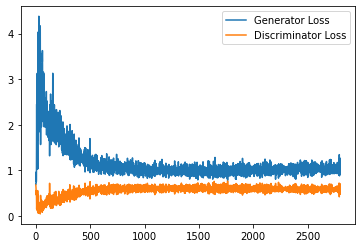

Step 56500: Generator loss: 1.0557681002616883, discriminator loss: 0.5771330363154411


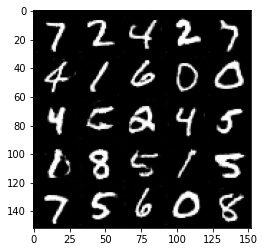

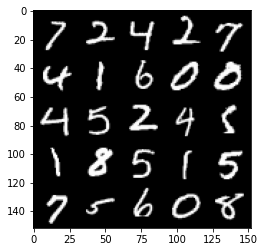

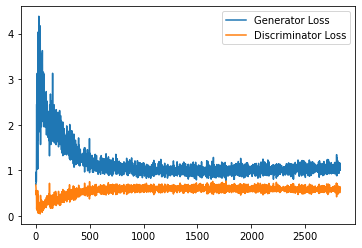

Step 57000: Generator loss: 1.0457825014591218, discriminator loss: 0.57832292252779


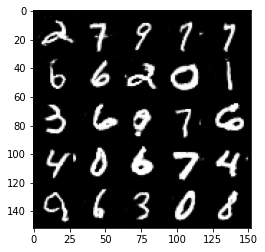

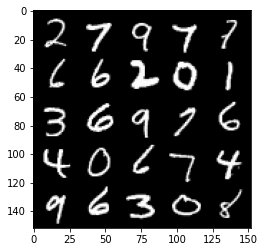

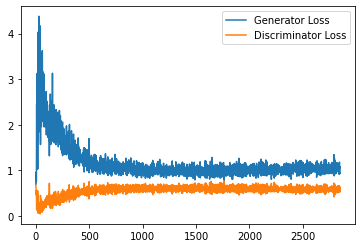

Step 57500: Generator loss: 1.0308354575634002, discriminator loss: 0.5722228204607963


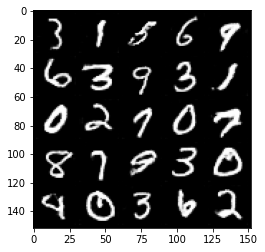

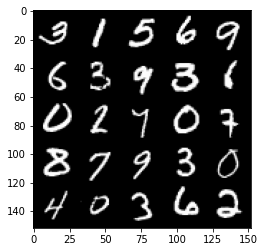

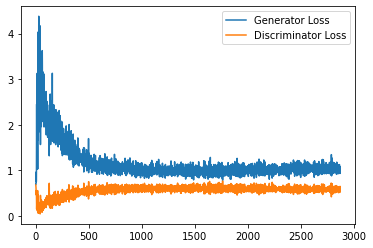

Step 58000: Generator loss: 1.0564965500831605, discriminator loss: 0.5688449453115463


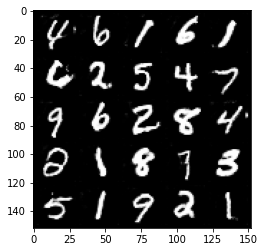

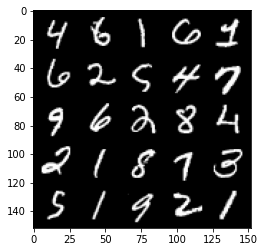

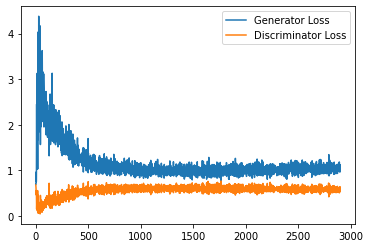

Step 58500: Generator loss: 1.0457813810110093, discriminator loss: 0.5742640861868858


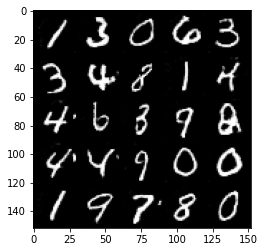

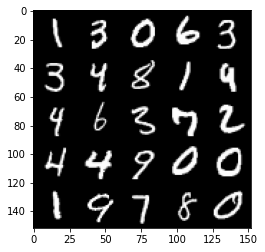

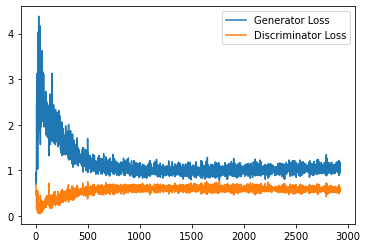

Step 59000: Generator loss: 1.0507600454092025, discriminator loss: 0.5685297382473946


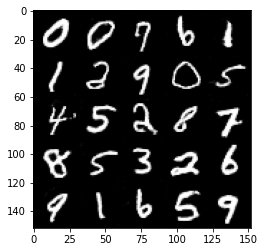

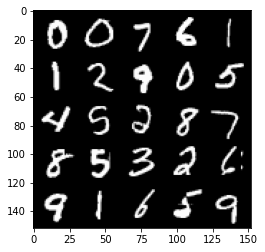

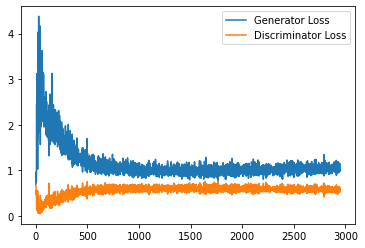

Step 59500: Generator loss: 1.052054211139679, discriminator loss: 0.575308690071106


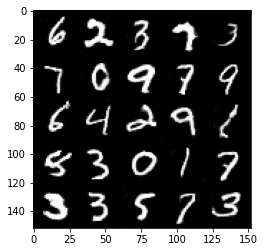

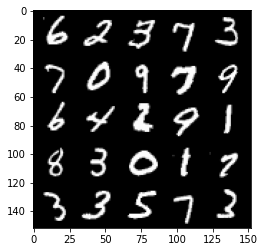

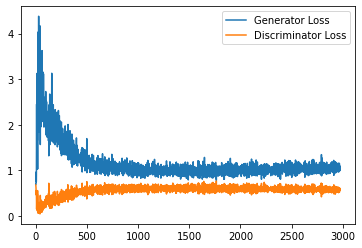

Step 60000: Generator loss: 1.0549819918870926, discriminator loss: 0.5662612652182579


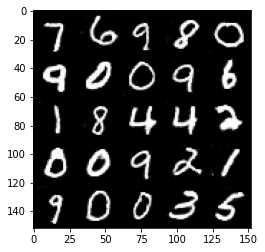

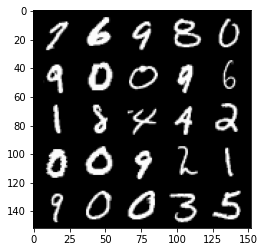

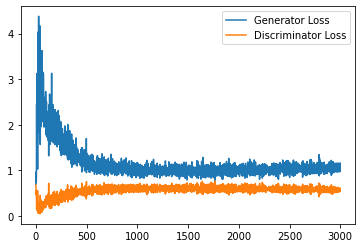

Step 60500: Generator loss: 1.0406169248223305, discriminator loss: 0.5728480863571167


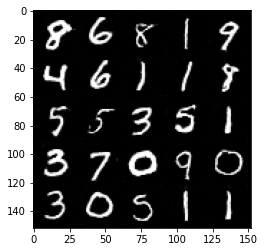

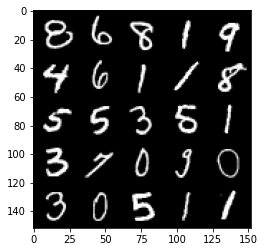

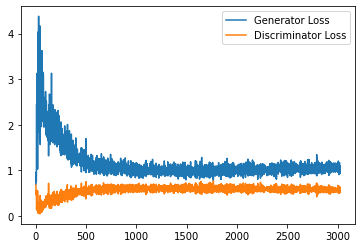

Step 61000: Generator loss: 1.049715642809868, discriminator loss: 0.5705144291520119


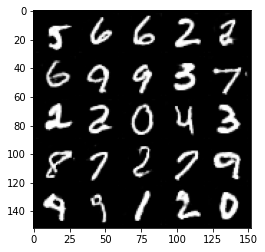

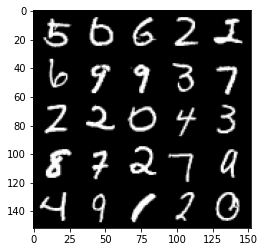

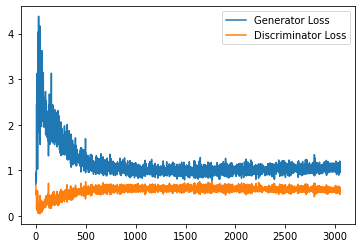

Step 61500: Generator loss: 1.0527008155584334, discriminator loss: 0.5693089770078659


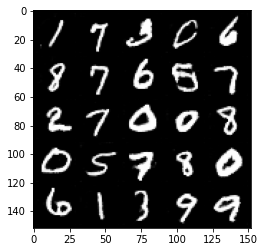

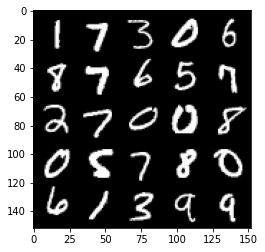

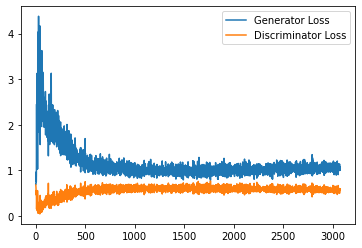

Step 62000: Generator loss: 1.0819393330812455, discriminator loss: 0.5615979219079018


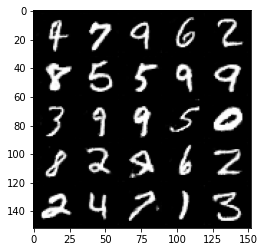

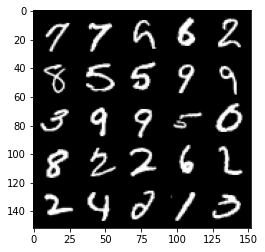

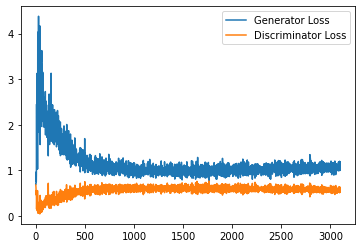

Step 62500: Generator loss: 1.0535828553438187, discriminator loss: 0.5676161943078041


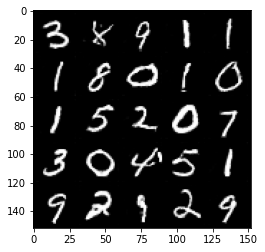

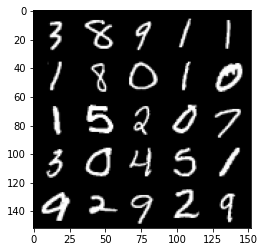

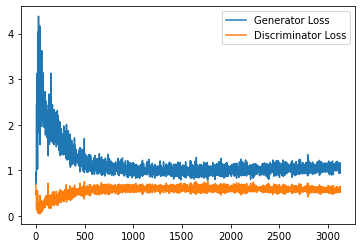

Step 63000: Generator loss: 1.0537636163234712, discriminator loss: 0.5690308669209481


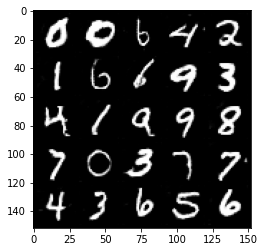

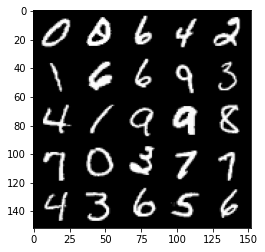

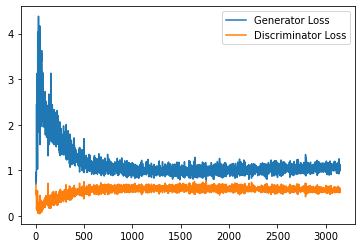

Step 63500: Generator loss: 1.0451247364282608, discriminator loss: 0.571894689321518


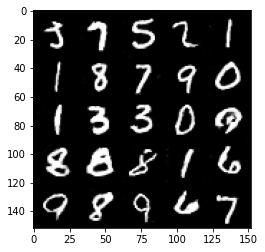

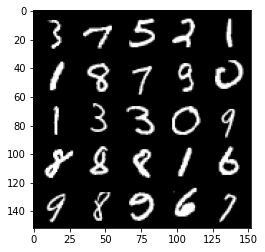

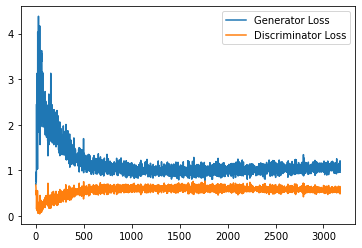

Step 64000: Generator loss: 1.0744079518318177, discriminator loss: 0.5698147429227829


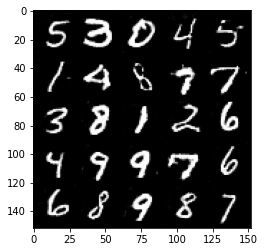

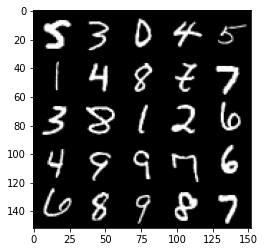

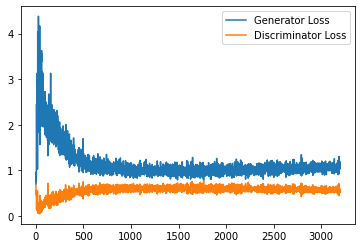

Step 64500: Generator loss: 1.075993945837021, discriminator loss: 0.5663440356850624


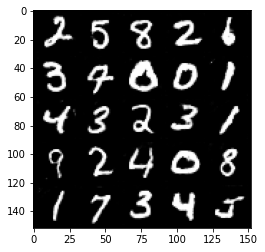

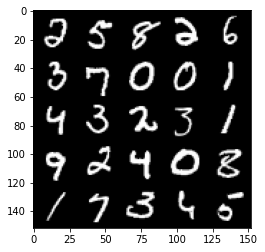

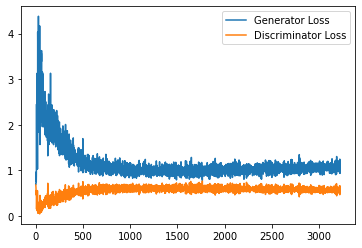

Step 65000: Generator loss: 1.0558386842012406, discriminator loss: 0.569535686314106


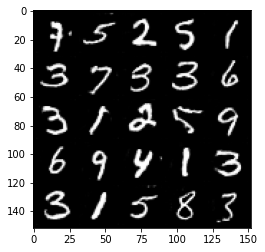

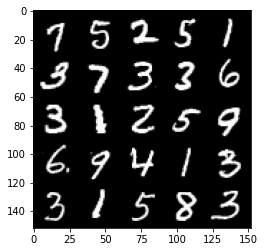

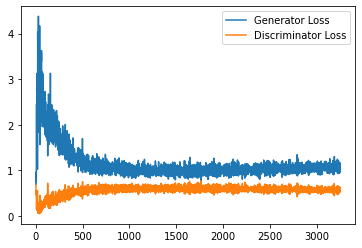

Step 65500: Generator loss: 1.0438306427001953, discriminator loss: 0.5729971312880516


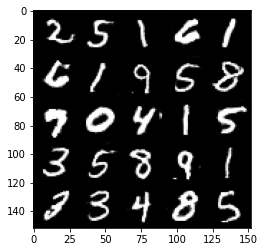

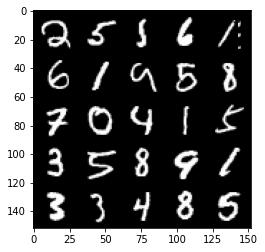

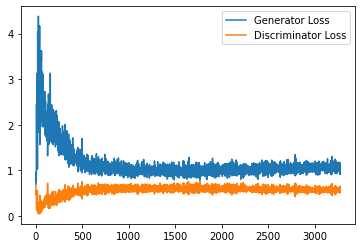

Step 66000: Generator loss: 1.071320737838745, discriminator loss: 0.5663880860209465


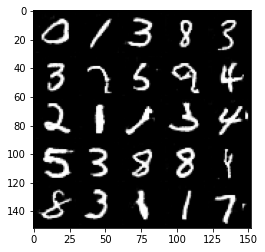

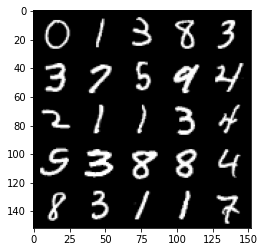

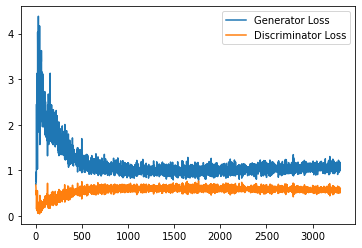

Step 66500: Generator loss: 1.0950006940364838, discriminator loss: 0.5609645652174949


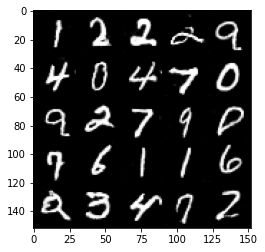

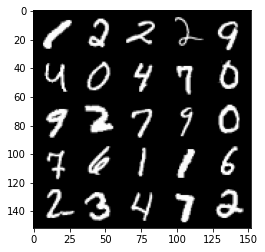

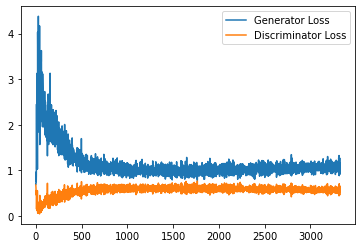

Step 67000: Generator loss: 1.050216813325882, discriminator loss: 0.5662454810738563


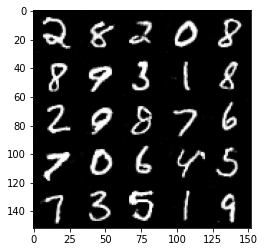

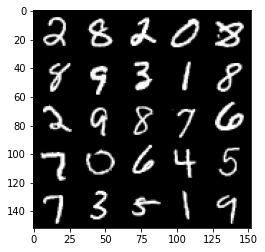

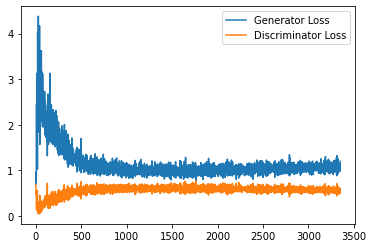

Step 67500: Generator loss: 1.1084096628427504, discriminator loss: 0.5641015565991402


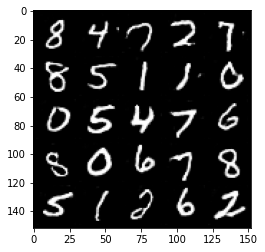

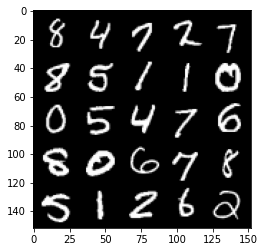

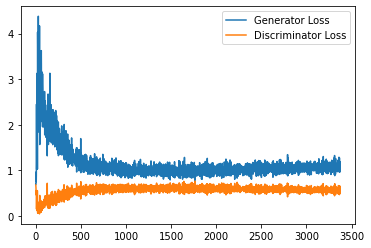

Step 68000: Generator loss: 1.0562564529180527, discriminator loss: 0.568619545519352


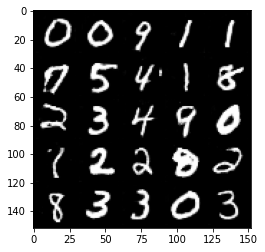

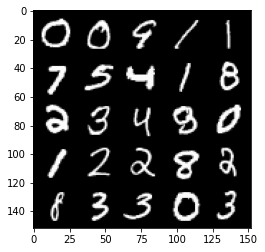

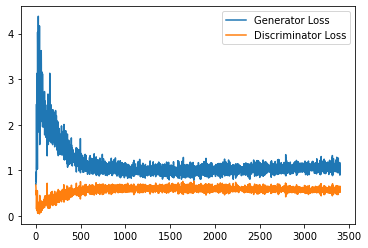

Step 68500: Generator loss: 1.0605066130161285, discriminator loss: 0.5648518426418304


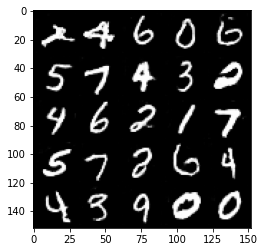

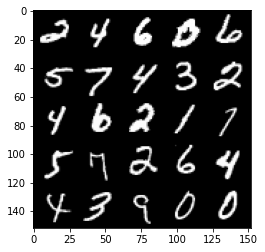

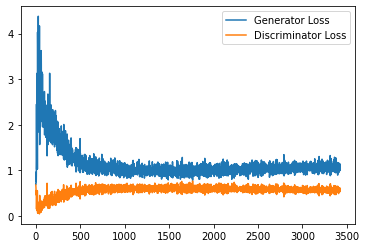

Step 69000: Generator loss: 1.0676158809661864, discriminator loss: 0.5645436107516288


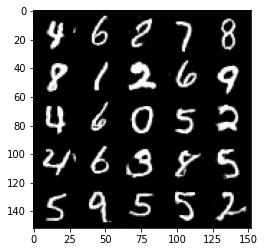

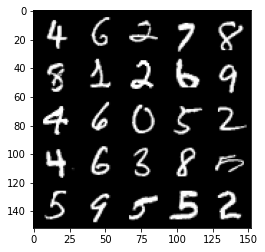

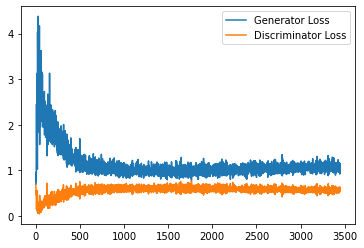

Step 69500: Generator loss: 1.0821105403900146, discriminator loss: 0.5647492437958718


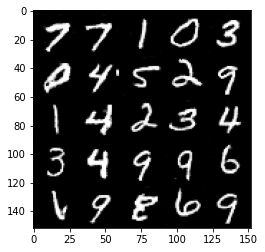

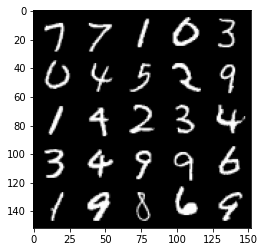

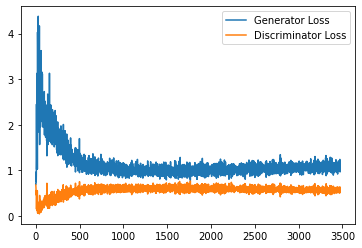

Step 70000: Generator loss: 1.0763828806877136, discriminator loss: 0.5612856389880181


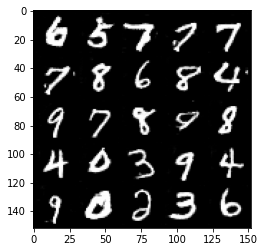

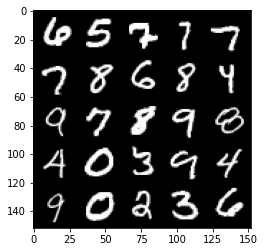

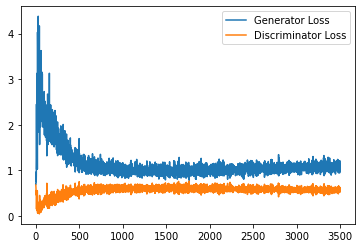

Step 70500: Generator loss: 1.0915819414854049, discriminator loss: 0.556433793604374


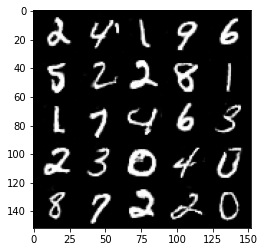

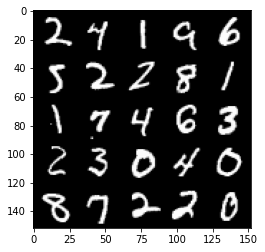

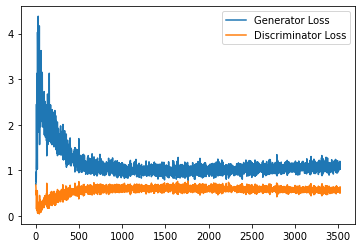

Step 71000: Generator loss: 1.0744091777801514, discriminator loss: 0.5636040828824044


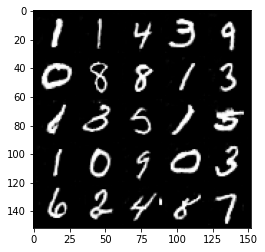

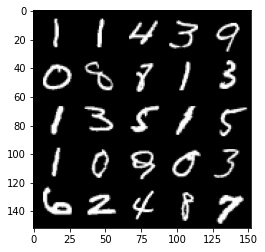

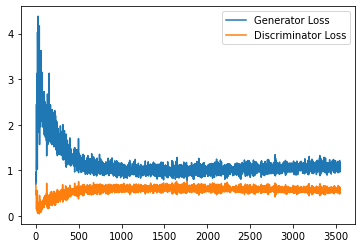

Step 71500: Generator loss: 1.1017061865329743, discriminator loss: 0.5621789862513542


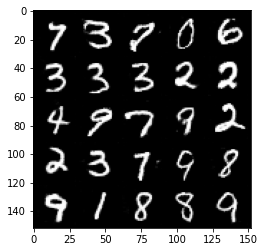

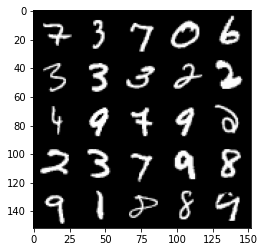

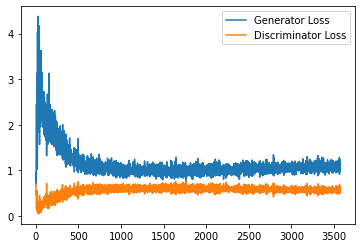

Step 72000: Generator loss: 1.0787385442256927, discriminator loss: 0.5602222637534141


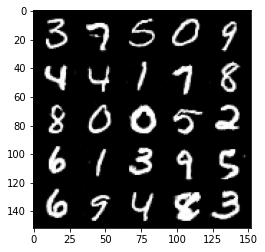

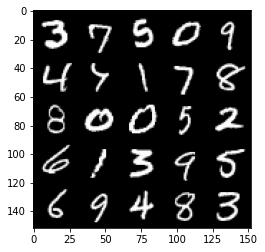

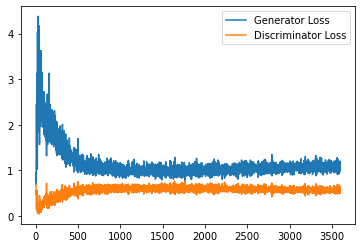

Step 72500: Generator loss: 1.0915453993082047, discriminator loss: 0.5580754955410957


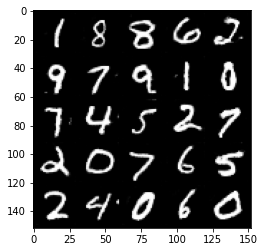

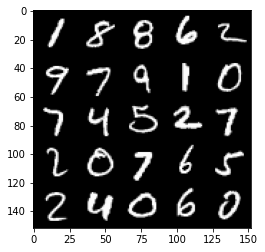

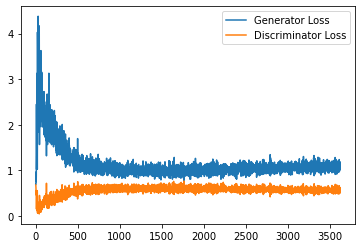

Step 73000: Generator loss: 1.0719854583740234, discriminator loss: 0.5670801978111267


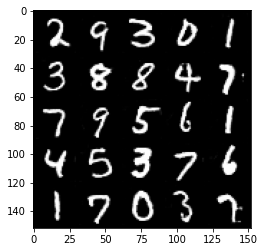

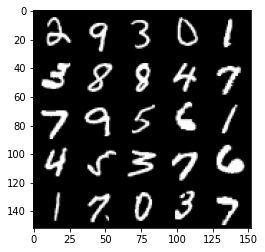

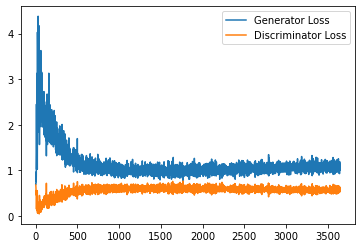

Step 73500: Generator loss: 1.0884209591150285, discriminator loss: 0.5541233580112457


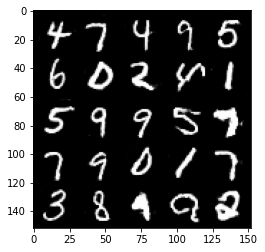

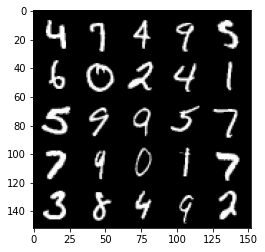

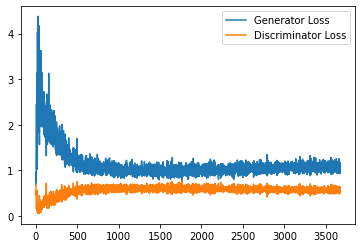

Step 74000: Generator loss: 1.0770711164474487, discriminator loss: 0.5625734776854515


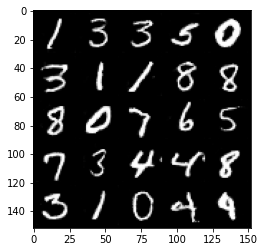

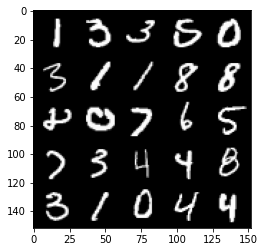

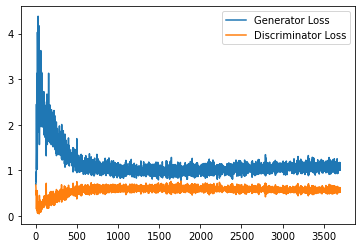

Step 74500: Generator loss: 1.0940750613212586, discriminator loss: 0.5574288711547851


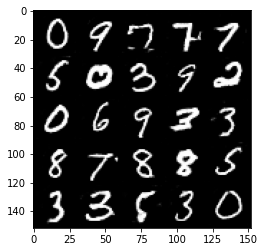

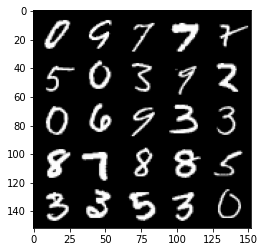

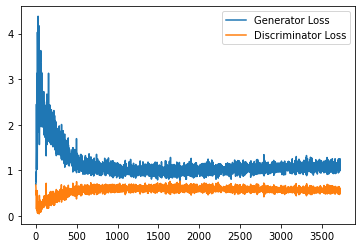

Step 75000: Generator loss: 1.096607452750206, discriminator loss: 0.5559867740869522


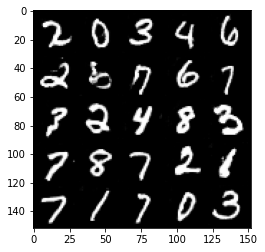

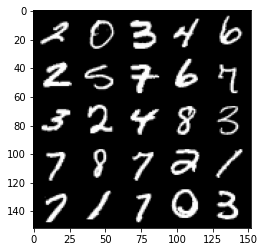

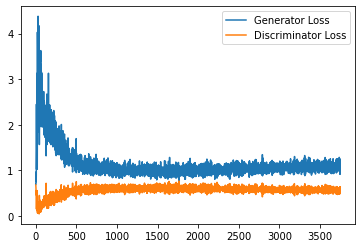

Step 75500: Generator loss: 1.0925370651483535, discriminator loss: 0.5621855490207672


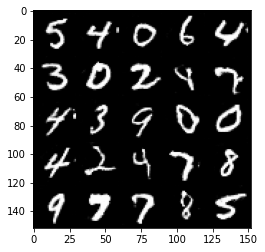

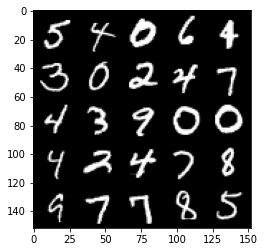

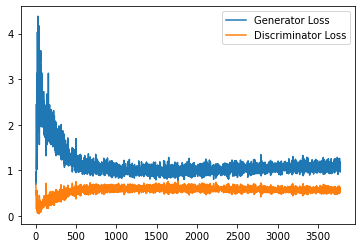

Step 76000: Generator loss: 1.0901173259019852, discriminator loss: 0.5549144965410232


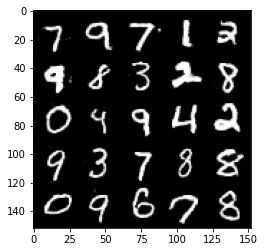

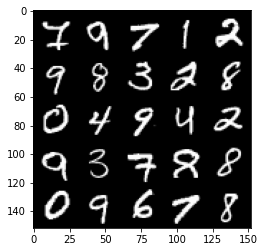

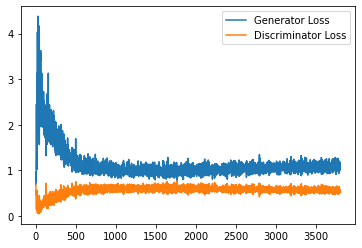

Step 76500: Generator loss: 1.0931295547485351, discriminator loss: 0.5507098226547241


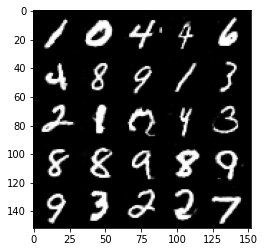

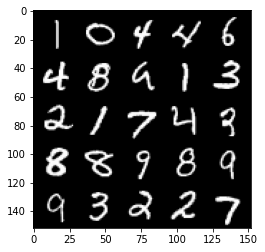

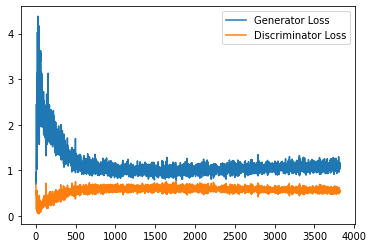

Step 77000: Generator loss: 1.0962754788398743, discriminator loss: 0.5535021401643753


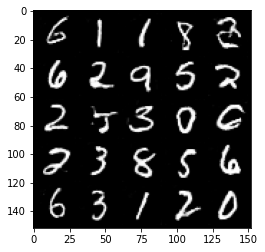

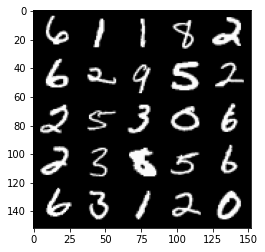

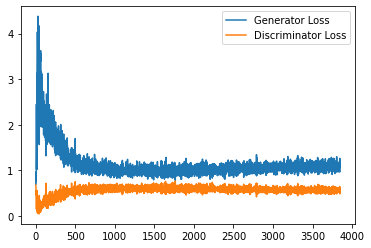

Step 77500: Generator loss: 1.1180417380332948, discriminator loss: 0.5565781089663505


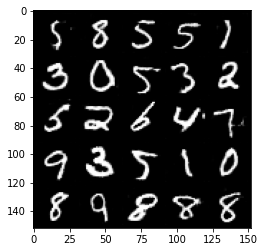

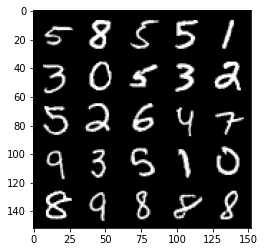

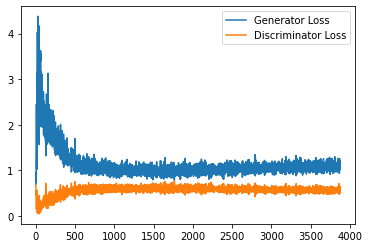

Step 78000: Generator loss: 1.1114602661132813, discriminator loss: 0.5582925818562507


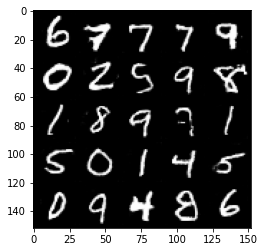

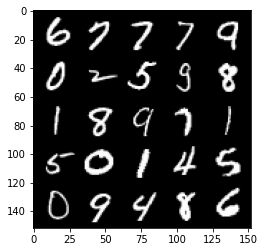

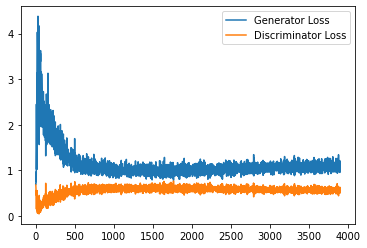

Step 78500: Generator loss: 1.1001074055433273, discriminator loss: 0.5534836181402206


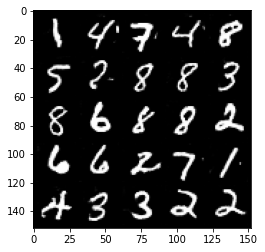

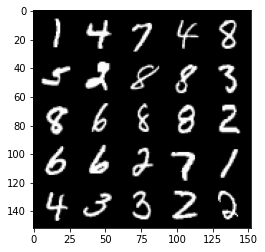

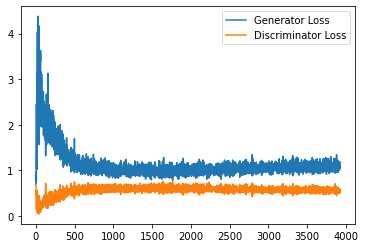

Step 79000: Generator loss: 1.103955373287201, discriminator loss: 0.5527846506237983


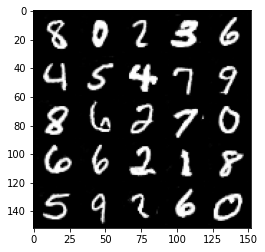

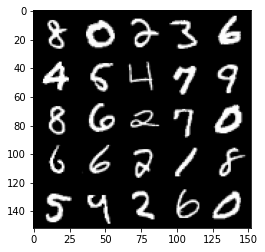

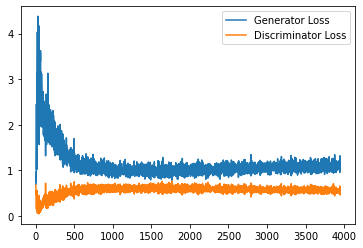

Step 79500: Generator loss: 1.111163161635399, discriminator loss: 0.5527961620092392


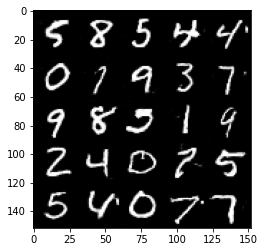

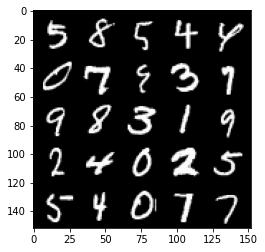

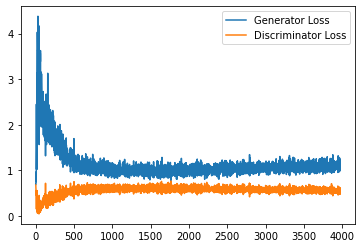

Step 80000: Generator loss: 1.092842991709709, discriminator loss: 0.556455352127552


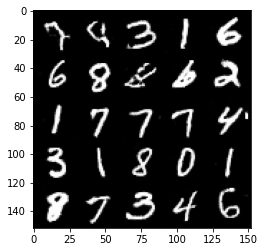

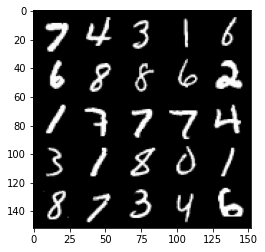

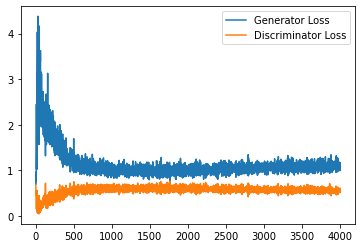

Step 80500: Generator loss: 1.1147247145175934, discriminator loss: 0.5504747671484947


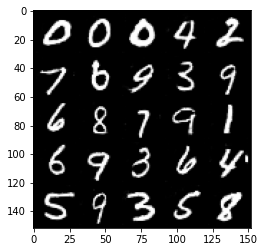

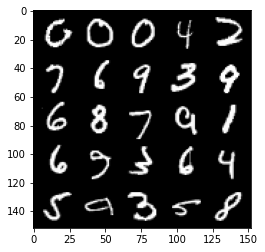

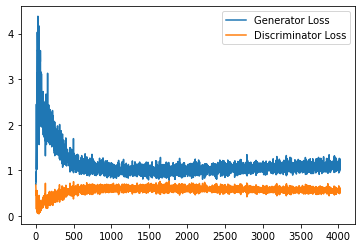

Step 81000: Generator loss: 1.1186242755651474, discriminator loss: 0.5489167644381523


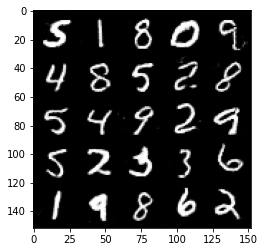

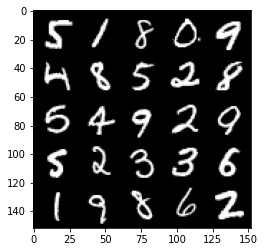

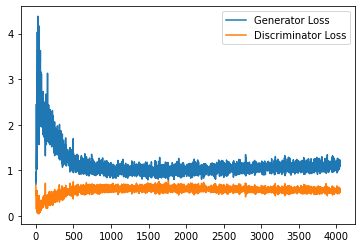

Step 81500: Generator loss: 1.099457577109337, discriminator loss: 0.5560431928634644


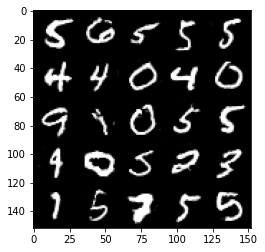

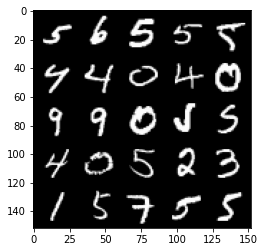

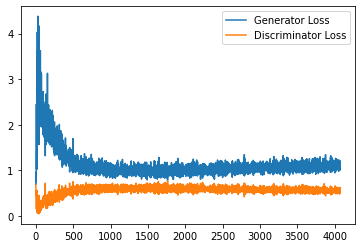

Step 82000: Generator loss: 1.1094880732297898, discriminator loss: 0.5500100374817848


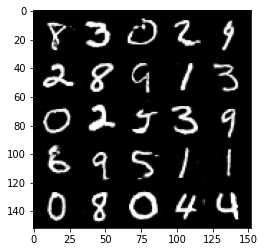

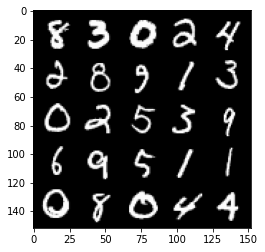

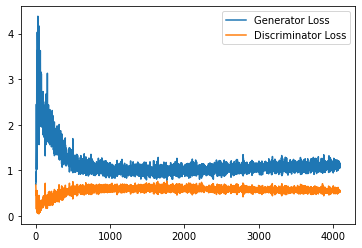

Step 82500: Generator loss: 1.0950888870954514, discriminator loss: 0.5511703801751137


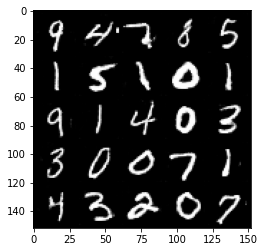

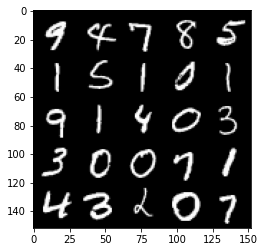

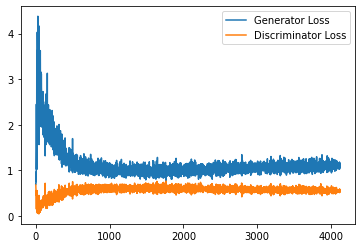

Step 83000: Generator loss: 1.142255873799324, discriminator loss: 0.5473346768021583


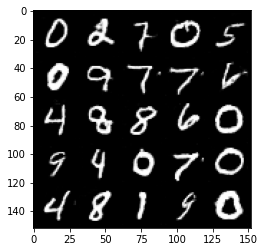

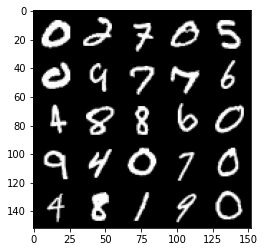

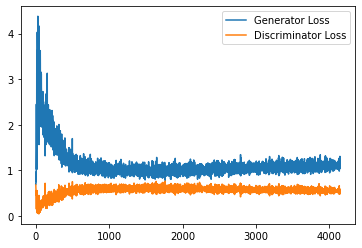

Step 83500: Generator loss: 1.1253783111572266, discriminator loss: 0.55243322712183


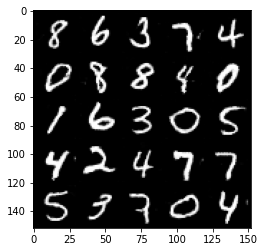

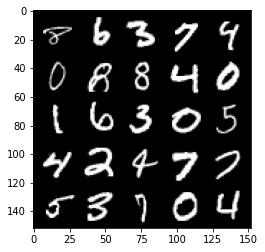

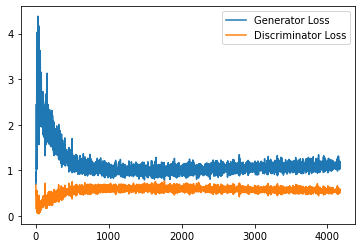

Step 84000: Generator loss: 1.1209292784929275, discriminator loss: 0.5506120020747185


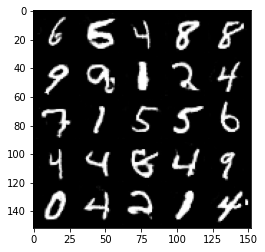

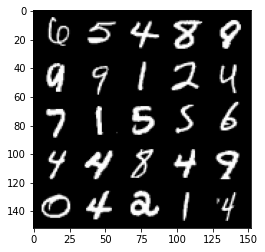

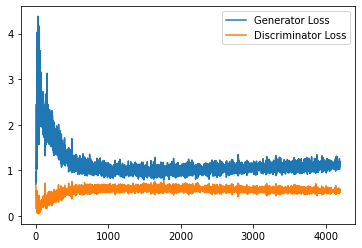

Step 84500: Generator loss: 1.1128313952684403, discriminator loss: 0.5500778660178185


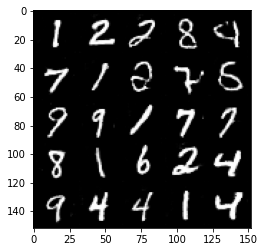

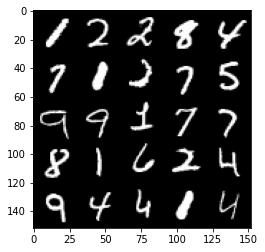

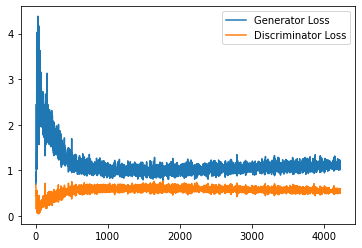

Step 85000: Generator loss: 1.1411538378000259, discriminator loss: 0.5498431268334388


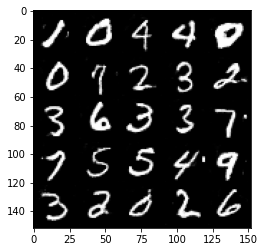

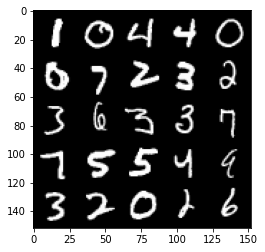

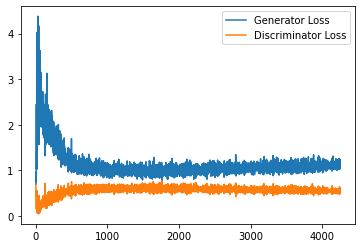

Step 85500: Generator loss: 1.1342168229818343, discriminator loss: 0.5444534748792649


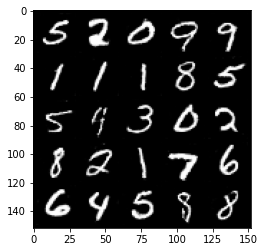

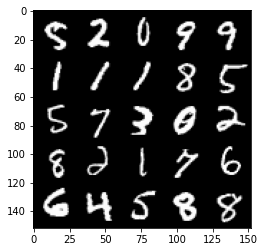

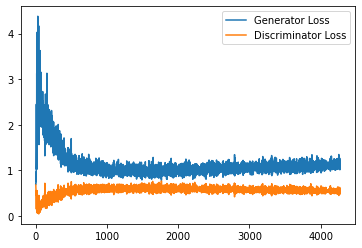

Step 86000: Generator loss: 1.1331308377981186, discriminator loss: 0.5536533154845238


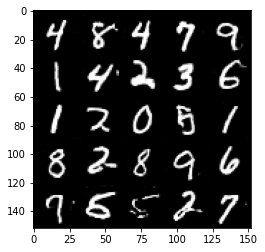

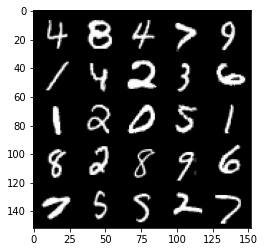

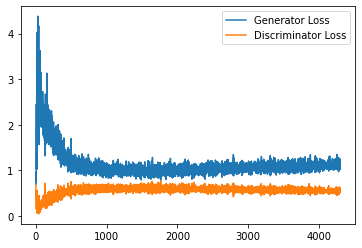

Step 86500: Generator loss: 1.115884440422058, discriminator loss: 0.5494882359504699


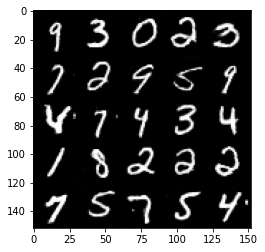

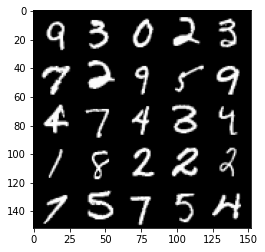

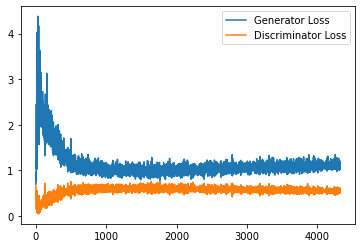

Step 87000: Generator loss: 1.128180835723877, discriminator loss: 0.556604335129261


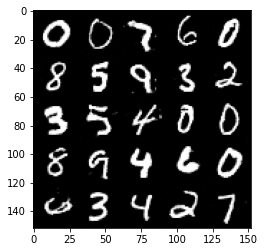

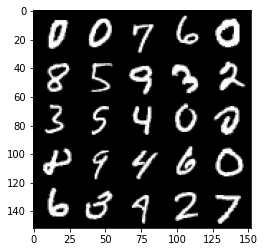

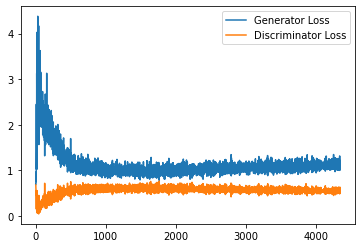

Step 87500: Generator loss: 1.1081671011447907, discriminator loss: 0.5516374593377114


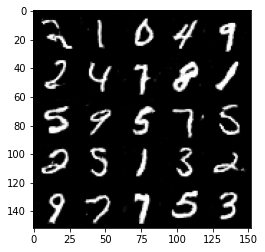

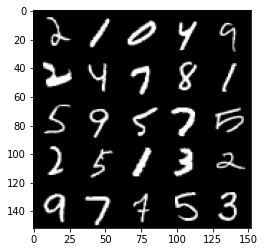

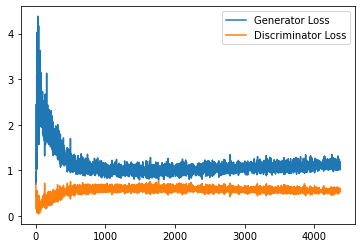

Step 88000: Generator loss: 1.1445391516685486, discriminator loss: 0.5534904693961143


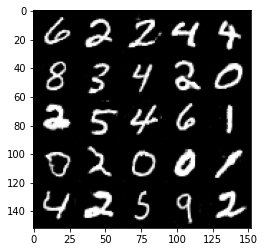

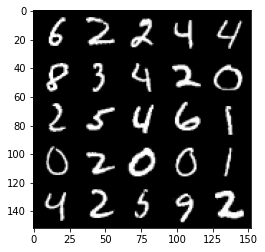

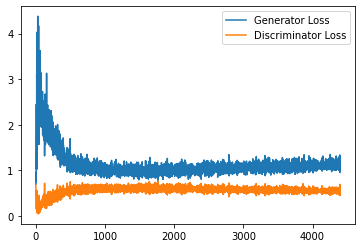

Step 88500: Generator loss: 1.1250779414176941, discriminator loss: 0.5511642320752144


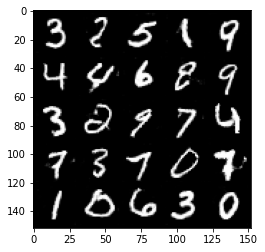

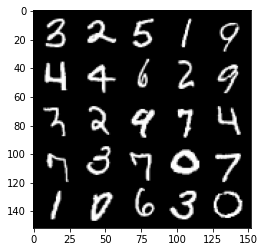

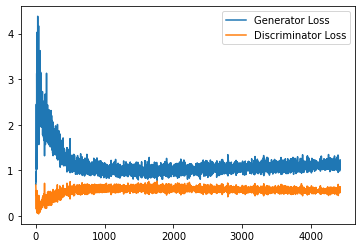

Step 89000: Generator loss: 1.1349513119459151, discriminator loss: 0.5557864035964012


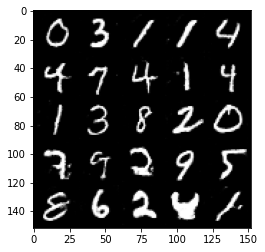

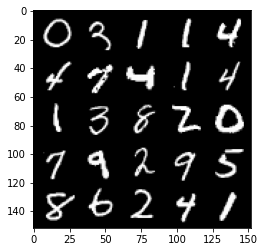

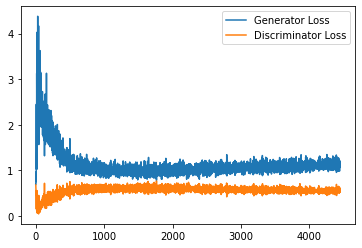

Step 89500: Generator loss: 1.1162308410406112, discriminator loss: 0.5547200962305069


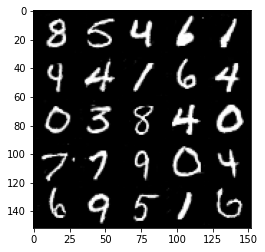

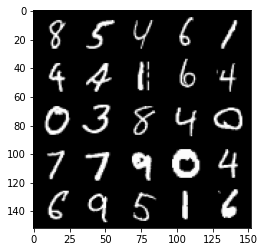

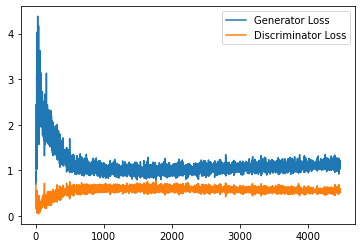

Step 90000: Generator loss: 1.1183967446088792, discriminator loss: 0.5574660958647728


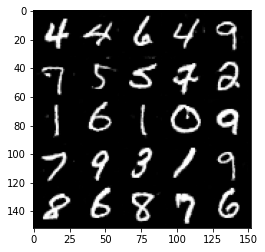

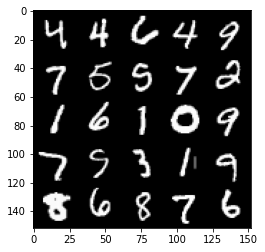

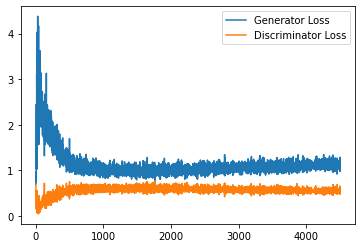

Step 90500: Generator loss: 1.1315375131368637, discriminator loss: 0.5485569504499436


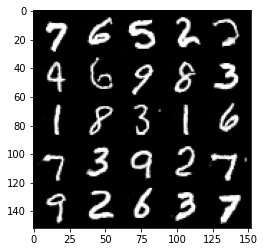

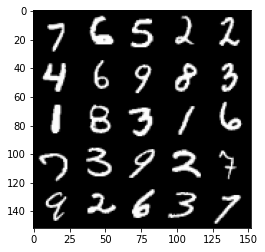

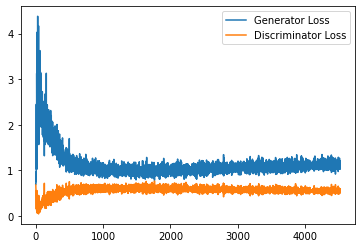

Step 91000: Generator loss: 1.121775898218155, discriminator loss: 0.5554521468877792


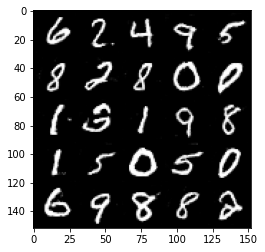

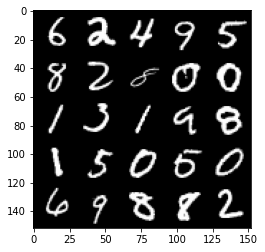

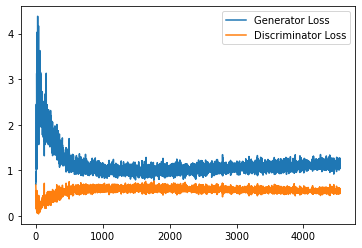

Step 91500: Generator loss: 1.1293820540905, discriminator loss: 0.5472259790301323


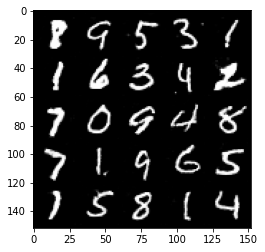

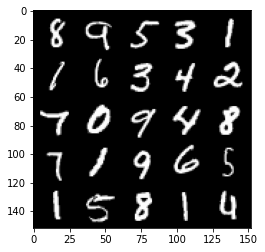

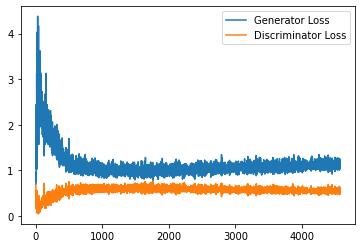

Step 92000: Generator loss: 1.1161282006502151, discriminator loss: 0.5566796375513077


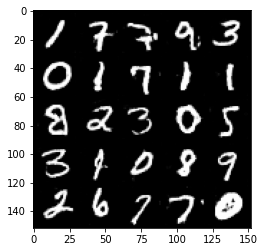

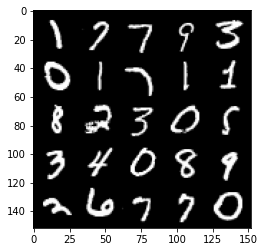

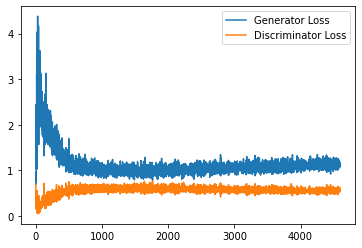

Step 92500: Generator loss: 1.1307495691776275, discriminator loss: 0.5484181203842163


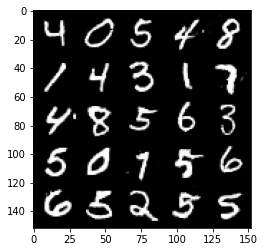

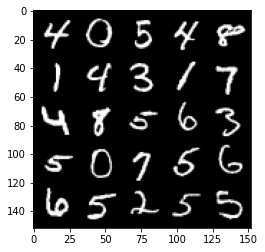

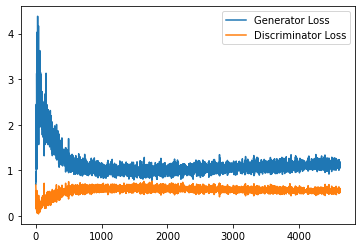

Step 93000: Generator loss: 1.1381254757642747, discriminator loss: 0.5562291669249535


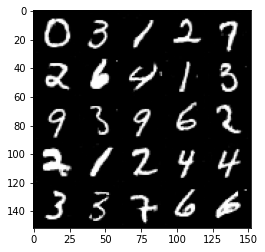

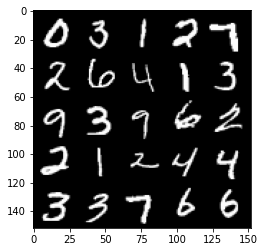

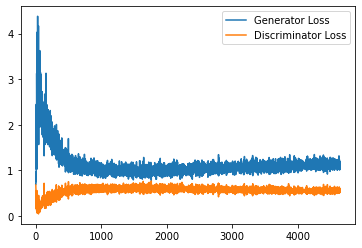

Step 93500: Generator loss: 1.123129503965378, discriminator loss: 0.5582367342114448


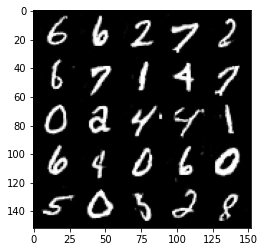

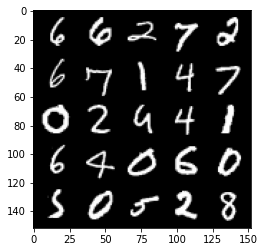

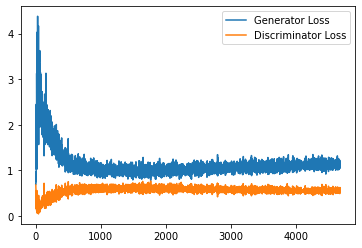

In [54]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [55]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

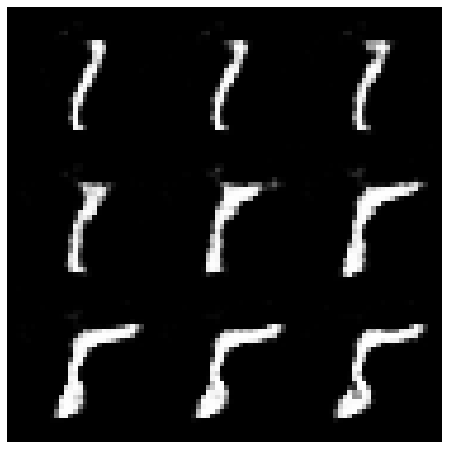

In [56]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

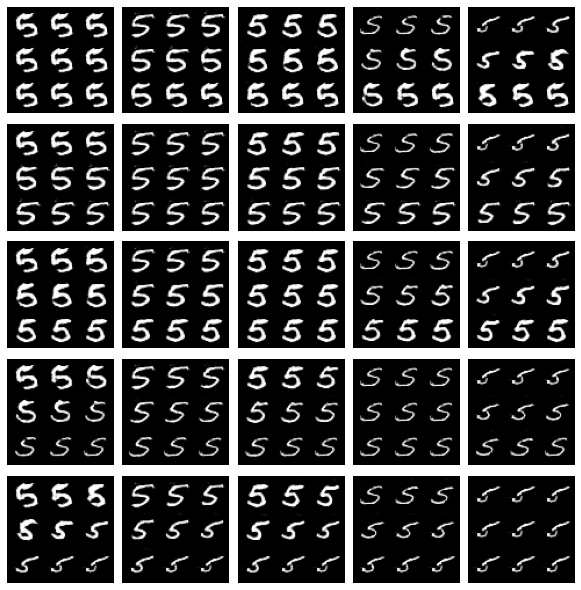

In [57]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()